# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ubuntu/.config/matplotlib/matplotlibrc", line #2
  (fname, cnt))
/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ubuntu/.config/matplotlib/matplotlibrc", line #3
  (fname, cnt))
/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:20, 8.79MB/s]                              
SVHN Testing Set: 64.3MB [00:08, 7.35MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

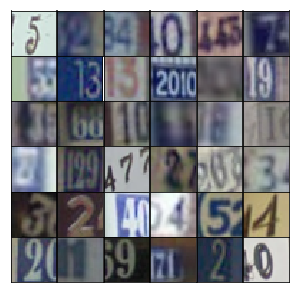

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [25]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        
        # 2nd Layer
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, 2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        # 3d layer
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, 2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)

        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, 2, padding='same')

        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [26]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x1 = tf.maximum(alpha * x1, x1)
        
        # 2nd layer
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        
        # 3rd layer
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        
        # Flatten the last layer
        x3 = tf.reshape(x3, (-1, 4*4*256))
        
        logits = tf.layers.dense(x3, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [27]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [28]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [29]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [30]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [31]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [32]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.0170... Generator Loss: 17.5802
Epoch 1/25... Discriminator Loss: 0.2087... Generator Loss: 8.9099
Epoch 1/25... Discriminator Loss: 0.7913... Generator Loss: 1.2779
Epoch 1/25... Discriminator Loss: 0.2659... Generator Loss: 2.2567
Epoch 1/25... Discriminator Loss: 0.9971... Generator Loss: 3.3143
Epoch 1/25... Discriminator Loss: 1.0751... Generator Loss: 1.5904
Epoch 1/25... Discriminator Loss: 0.4414... Generator Loss: 2.0767
Epoch 1/25... Discriminator Loss: 0.7245... Generator Loss: 0.8210
Epoch 1/25... Discriminator Loss: 0.8428... Generator Loss: 0.7794
Epoch 1/25... Discriminator Loss: 0.7292... Generator Loss: 1.3938


/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


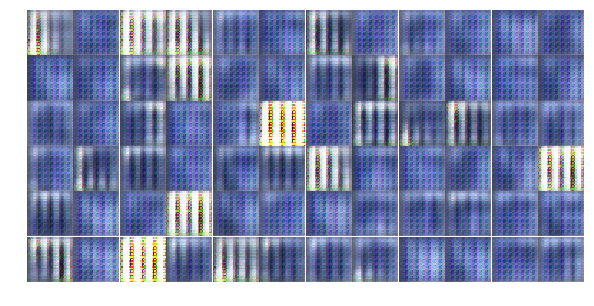

Epoch 1/25... Discriminator Loss: 1.1834... Generator Loss: 1.2544
Epoch 1/25... Discriminator Loss: 0.4466... Generator Loss: 2.0601
Epoch 1/25... Discriminator Loss: 0.5919... Generator Loss: 1.3769
Epoch 1/25... Discriminator Loss: 0.1775... Generator Loss: 2.5559
Epoch 1/25... Discriminator Loss: 1.9407... Generator Loss: 1.0164
Epoch 1/25... Discriminator Loss: 2.1755... Generator Loss: 1.5984
Epoch 1/25... Discriminator Loss: 1.0117... Generator Loss: 0.7519
Epoch 1/25... Discriminator Loss: 1.0628... Generator Loss: 0.7020
Epoch 1/25... Discriminator Loss: 1.0225... Generator Loss: 0.7862
Epoch 1/25... Discriminator Loss: 3.1299... Generator Loss: 0.1914


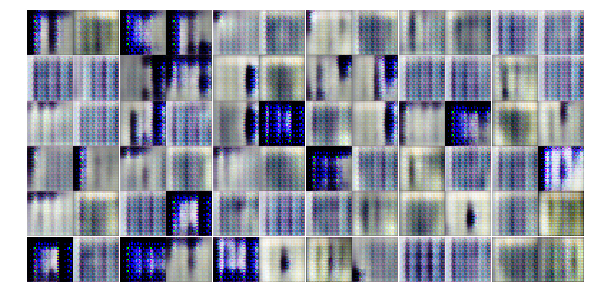

Epoch 1/25... Discriminator Loss: 1.1342... Generator Loss: 0.7143
Epoch 1/25... Discriminator Loss: 0.7228... Generator Loss: 2.5365
Epoch 1/25... Discriminator Loss: 0.8374... Generator Loss: 1.2489
Epoch 1/25... Discriminator Loss: 1.4698... Generator Loss: 1.5967
Epoch 1/25... Discriminator Loss: 1.1862... Generator Loss: 0.5353
Epoch 1/25... Discriminator Loss: 6.4055... Generator Loss: 6.2778
Epoch 1/25... Discriminator Loss: 0.6175... Generator Loss: 1.4070
Epoch 1/25... Discriminator Loss: 1.0614... Generator Loss: 0.8934
Epoch 1/25... Discriminator Loss: 3.5688... Generator Loss: 3.9914
Epoch 1/25... Discriminator Loss: 0.7344... Generator Loss: 1.6675


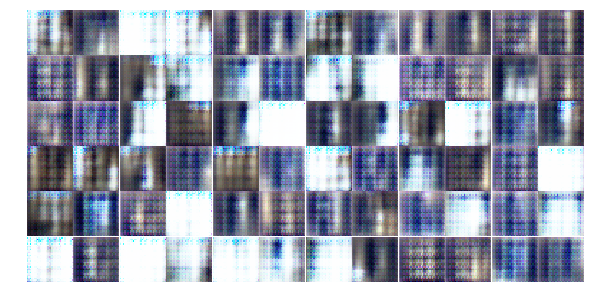

Epoch 1/25... Discriminator Loss: 0.9595... Generator Loss: 1.2197
Epoch 1/25... Discriminator Loss: 1.3660... Generator Loss: 0.4307
Epoch 1/25... Discriminator Loss: 0.8615... Generator Loss: 0.8406
Epoch 1/25... Discriminator Loss: 1.0220... Generator Loss: 2.0247
Epoch 1/25... Discriminator Loss: 0.8837... Generator Loss: 0.8456
Epoch 1/25... Discriminator Loss: 2.4073... Generator Loss: 0.5875
Epoch 1/25... Discriminator Loss: 1.3717... Generator Loss: 0.5733
Epoch 1/25... Discriminator Loss: 0.6962... Generator Loss: 1.2914
Epoch 1/25... Discriminator Loss: 1.8802... Generator Loss: 0.2535
Epoch 1/25... Discriminator Loss: 1.0458... Generator Loss: 1.0767


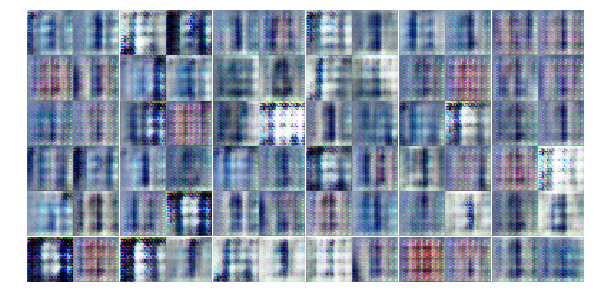

Epoch 1/25... Discriminator Loss: 1.3421... Generator Loss: 0.8391
Epoch 1/25... Discriminator Loss: 1.8239... Generator Loss: 0.4531
Epoch 1/25... Discriminator Loss: 1.3116... Generator Loss: 0.7816
Epoch 1/25... Discriminator Loss: 1.2729... Generator Loss: 1.0048
Epoch 1/25... Discriminator Loss: 1.1000... Generator Loss: 0.9686
Epoch 1/25... Discriminator Loss: 0.9963... Generator Loss: 1.5608
Epoch 1/25... Discriminator Loss: 1.3064... Generator Loss: 0.5535
Epoch 1/25... Discriminator Loss: 1.1472... Generator Loss: 0.8099
Epoch 1/25... Discriminator Loss: 1.5830... Generator Loss: 2.2158
Epoch 1/25... Discriminator Loss: 1.3629... Generator Loss: 2.2827


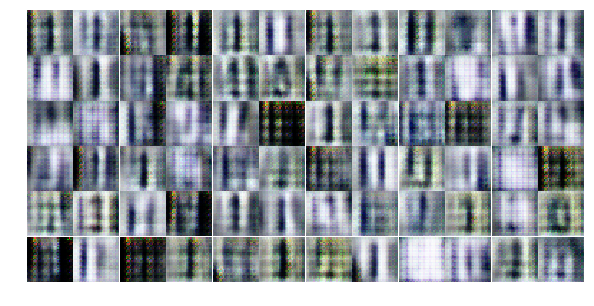

Epoch 1/25... Discriminator Loss: 1.2188... Generator Loss: 0.7691
Epoch 1/25... Discriminator Loss: 0.5595... Generator Loss: 1.3079
Epoch 1/25... Discriminator Loss: 1.2084... Generator Loss: 1.2305
Epoch 1/25... Discriminator Loss: 1.2409... Generator Loss: 0.6974
Epoch 1/25... Discriminator Loss: 1.2810... Generator Loss: 1.1350
Epoch 1/25... Discriminator Loss: 1.2723... Generator Loss: 0.7503
Epoch 1/25... Discriminator Loss: 1.3980... Generator Loss: 0.7035
Epoch 2/25... Discriminator Loss: 1.2100... Generator Loss: 0.6073
Epoch 2/25... Discriminator Loss: 1.1120... Generator Loss: 0.9666
Epoch 2/25... Discriminator Loss: 1.1778... Generator Loss: 1.5898


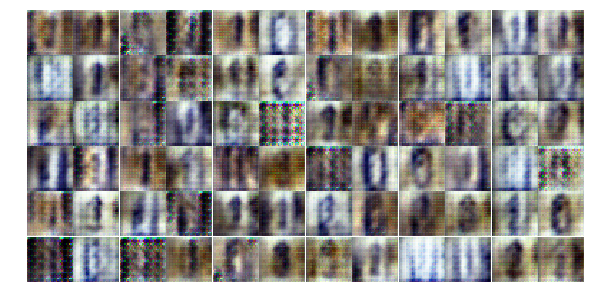

Epoch 2/25... Discriminator Loss: 1.4075... Generator Loss: 0.9368
Epoch 2/25... Discriminator Loss: 0.9110... Generator Loss: 1.3241
Epoch 2/25... Discriminator Loss: 1.4016... Generator Loss: 0.5246
Epoch 2/25... Discriminator Loss: 1.1565... Generator Loss: 1.3727
Epoch 2/25... Discriminator Loss: 0.9752... Generator Loss: 0.7953
Epoch 2/25... Discriminator Loss: 0.9352... Generator Loss: 1.1217
Epoch 2/25... Discriminator Loss: 1.5293... Generator Loss: 1.0228
Epoch 2/25... Discriminator Loss: 1.2975... Generator Loss: 0.8501
Epoch 2/25... Discriminator Loss: 1.4779... Generator Loss: 0.4634
Epoch 2/25... Discriminator Loss: 1.6013... Generator Loss: 0.8273


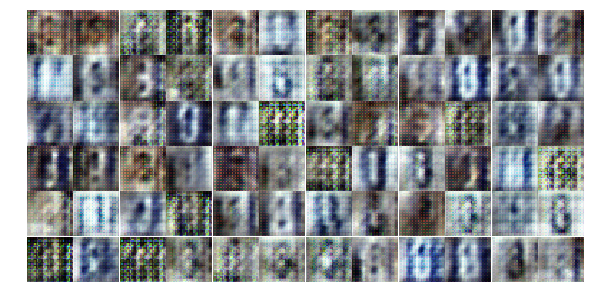

Epoch 2/25... Discriminator Loss: 1.3387... Generator Loss: 0.6762
Epoch 2/25... Discriminator Loss: 1.2095... Generator Loss: 0.9928
Epoch 2/25... Discriminator Loss: 1.1103... Generator Loss: 0.8958
Epoch 2/25... Discriminator Loss: 0.7493... Generator Loss: 0.8925
Epoch 2/25... Discriminator Loss: 1.5712... Generator Loss: 0.6167
Epoch 2/25... Discriminator Loss: 1.3723... Generator Loss: 0.8608
Epoch 2/25... Discriminator Loss: 1.1616... Generator Loss: 1.0968
Epoch 2/25... Discriminator Loss: 1.2987... Generator Loss: 1.0167
Epoch 2/25... Discriminator Loss: 1.1567... Generator Loss: 0.8239
Epoch 2/25... Discriminator Loss: 1.2291... Generator Loss: 0.7957


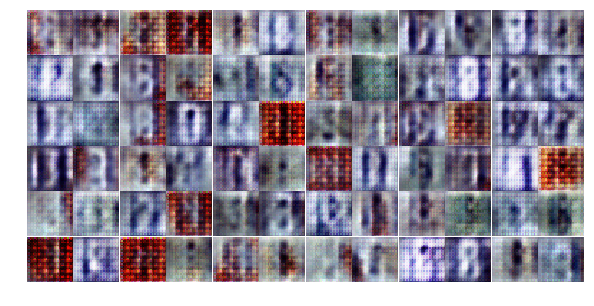

Epoch 2/25... Discriminator Loss: 0.9942... Generator Loss: 1.1707
Epoch 2/25... Discriminator Loss: 1.2761... Generator Loss: 1.0587
Epoch 2/25... Discriminator Loss: 0.9797... Generator Loss: 1.9514
Epoch 2/25... Discriminator Loss: 1.3806... Generator Loss: 0.5035
Epoch 2/25... Discriminator Loss: 1.2286... Generator Loss: 0.9432
Epoch 2/25... Discriminator Loss: 1.0689... Generator Loss: 1.2561
Epoch 2/25... Discriminator Loss: 0.9819... Generator Loss: 0.7831
Epoch 2/25... Discriminator Loss: 1.2374... Generator Loss: 0.9397
Epoch 2/25... Discriminator Loss: 1.2025... Generator Loss: 0.8852
Epoch 2/25... Discriminator Loss: 1.7473... Generator Loss: 0.7572


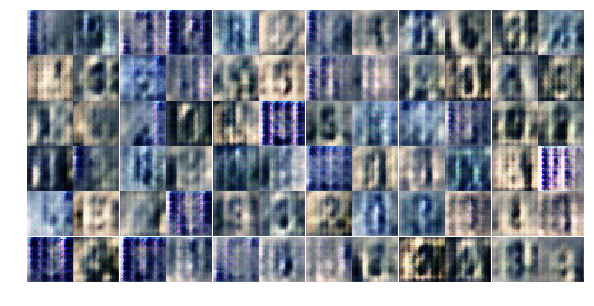

Epoch 2/25... Discriminator Loss: 1.3519... Generator Loss: 0.7006
Epoch 2/25... Discriminator Loss: 1.3561... Generator Loss: 0.6800
Epoch 2/25... Discriminator Loss: 1.2615... Generator Loss: 0.7543
Epoch 2/25... Discriminator Loss: 1.4175... Generator Loss: 0.6692
Epoch 2/25... Discriminator Loss: 0.9389... Generator Loss: 1.0632
Epoch 2/25... Discriminator Loss: 1.3256... Generator Loss: 1.0097
Epoch 2/25... Discriminator Loss: 1.5657... Generator Loss: 0.5294
Epoch 2/25... Discriminator Loss: 1.3595... Generator Loss: 0.7932
Epoch 2/25... Discriminator Loss: 1.3423... Generator Loss: 0.8757
Epoch 2/25... Discriminator Loss: 1.0821... Generator Loss: 0.7988


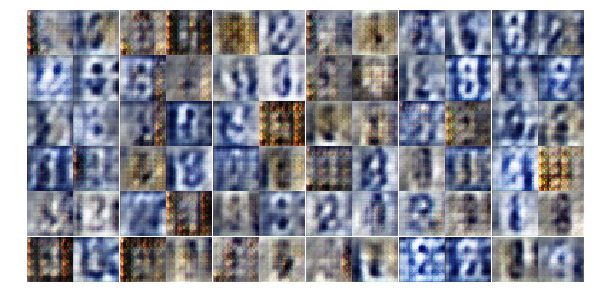

Epoch 2/25... Discriminator Loss: 1.0574... Generator Loss: 1.0421
Epoch 2/25... Discriminator Loss: 1.0888... Generator Loss: 0.9239
Epoch 2/25... Discriminator Loss: 1.2087... Generator Loss: 0.9423
Epoch 2/25... Discriminator Loss: 1.2406... Generator Loss: 1.3269
Epoch 2/25... Discriminator Loss: 1.3388... Generator Loss: 0.8765
Epoch 2/25... Discriminator Loss: 1.7579... Generator Loss: 0.3417
Epoch 2/25... Discriminator Loss: 1.4774... Generator Loss: 1.3946
Epoch 2/25... Discriminator Loss: 1.1508... Generator Loss: 0.6011
Epoch 2/25... Discriminator Loss: 1.2993... Generator Loss: 0.5863
Epoch 2/25... Discriminator Loss: 1.4090... Generator Loss: 0.8221


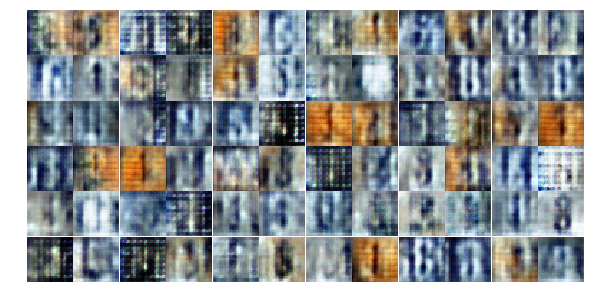

Epoch 2/25... Discriminator Loss: 1.3491... Generator Loss: 0.6850
Epoch 2/25... Discriminator Loss: 1.4230... Generator Loss: 0.8613
Epoch 2/25... Discriminator Loss: 1.6589... Generator Loss: 0.5076
Epoch 2/25... Discriminator Loss: 1.3723... Generator Loss: 1.7464
Epoch 3/25... Discriminator Loss: 1.1057... Generator Loss: 0.9262
Epoch 3/25... Discriminator Loss: 1.4275... Generator Loss: 0.8958
Epoch 3/25... Discriminator Loss: 1.1552... Generator Loss: 0.7331
Epoch 3/25... Discriminator Loss: 1.5080... Generator Loss: 0.6555
Epoch 3/25... Discriminator Loss: 1.4078... Generator Loss: 1.6655
Epoch 3/25... Discriminator Loss: 1.1276... Generator Loss: 1.1054


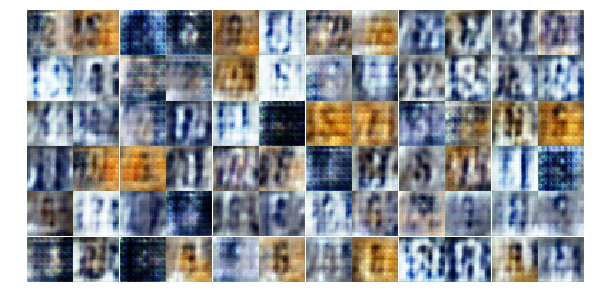

Epoch 3/25... Discriminator Loss: 0.9610... Generator Loss: 1.1008
Epoch 3/25... Discriminator Loss: 1.3976... Generator Loss: 0.7717
Epoch 3/25... Discriminator Loss: 1.1186... Generator Loss: 0.6747
Epoch 3/25... Discriminator Loss: 0.7766... Generator Loss: 0.9282
Epoch 3/25... Discriminator Loss: 1.4587... Generator Loss: 0.7217
Epoch 3/25... Discriminator Loss: 1.4090... Generator Loss: 0.8862
Epoch 3/25... Discriminator Loss: 1.2984... Generator Loss: 1.1983
Epoch 3/25... Discriminator Loss: 1.4553... Generator Loss: 0.6640
Epoch 3/25... Discriminator Loss: 1.1588... Generator Loss: 0.9331
Epoch 3/25... Discriminator Loss: 1.3348... Generator Loss: 1.8916


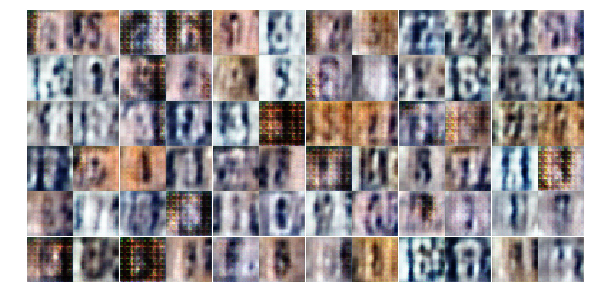

Epoch 3/25... Discriminator Loss: 1.0895... Generator Loss: 0.9275
Epoch 3/25... Discriminator Loss: 1.3448... Generator Loss: 0.7322
Epoch 3/25... Discriminator Loss: 0.9261... Generator Loss: 0.8620
Epoch 3/25... Discriminator Loss: 0.9660... Generator Loss: 1.2559
Epoch 3/25... Discriminator Loss: 2.0137... Generator Loss: 1.5689
Epoch 3/25... Discriminator Loss: 1.4334... Generator Loss: 2.1355
Epoch 3/25... Discriminator Loss: 0.8881... Generator Loss: 1.3708
Epoch 3/25... Discriminator Loss: 1.1512... Generator Loss: 0.5154
Epoch 3/25... Discriminator Loss: 0.5865... Generator Loss: 1.8571
Epoch 3/25... Discriminator Loss: 1.5979... Generator Loss: 0.4983


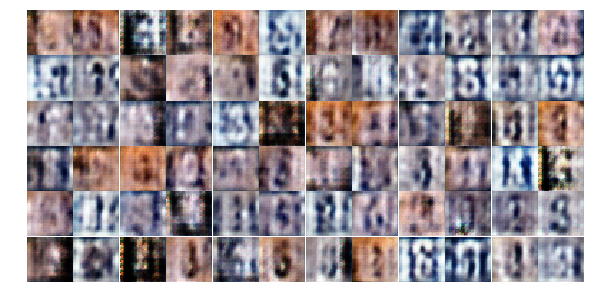

Epoch 3/25... Discriminator Loss: 1.3070... Generator Loss: 0.7157
Epoch 3/25... Discriminator Loss: 1.4402... Generator Loss: 0.8657
Epoch 3/25... Discriminator Loss: 1.3450... Generator Loss: 0.8327
Epoch 3/25... Discriminator Loss: 1.5482... Generator Loss: 0.5720
Epoch 3/25... Discriminator Loss: 2.1917... Generator Loss: 0.2104
Epoch 3/25... Discriminator Loss: 0.9326... Generator Loss: 0.9125
Epoch 3/25... Discriminator Loss: 1.6003... Generator Loss: 0.7543
Epoch 3/25... Discriminator Loss: 0.8974... Generator Loss: 1.2432
Epoch 3/25... Discriminator Loss: 1.5346... Generator Loss: 1.2499
Epoch 3/25... Discriminator Loss: 0.6778... Generator Loss: 1.5680


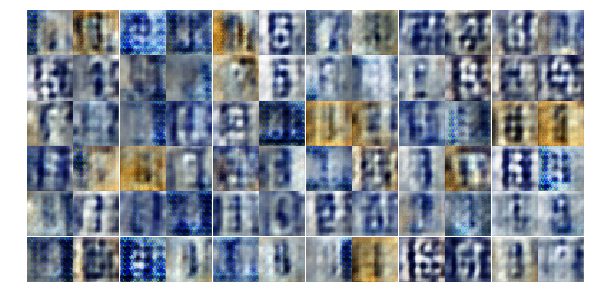

Epoch 3/25... Discriminator Loss: 1.4669... Generator Loss: 0.4442
Epoch 3/25... Discriminator Loss: 1.0525... Generator Loss: 0.6321
Epoch 3/25... Discriminator Loss: 1.1121... Generator Loss: 0.6123
Epoch 3/25... Discriminator Loss: 1.2785... Generator Loss: 0.8278
Epoch 3/25... Discriminator Loss: 1.1215... Generator Loss: 0.9373
Epoch 3/25... Discriminator Loss: 1.2839... Generator Loss: 0.7799
Epoch 3/25... Discriminator Loss: 1.3245... Generator Loss: 0.5752
Epoch 3/25... Discriminator Loss: 1.2490... Generator Loss: 1.1880
Epoch 3/25... Discriminator Loss: 1.0044... Generator Loss: 1.3014
Epoch 3/25... Discriminator Loss: 1.1811... Generator Loss: 0.9767


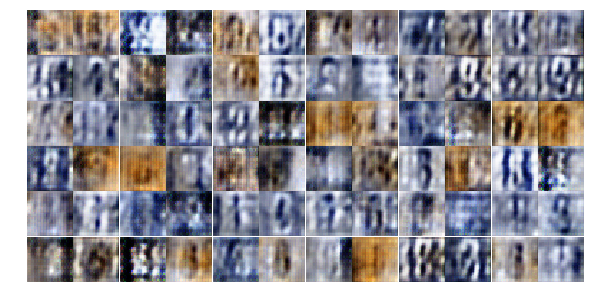

Epoch 3/25... Discriminator Loss: 1.2901... Generator Loss: 0.8655
Epoch 3/25... Discriminator Loss: 0.9482... Generator Loss: 1.3834
Epoch 3/25... Discriminator Loss: 0.6985... Generator Loss: 1.2714
Epoch 3/25... Discriminator Loss: 1.2296... Generator Loss: 1.0888
Epoch 3/25... Discriminator Loss: 1.2992... Generator Loss: 1.1180
Epoch 3/25... Discriminator Loss: 1.3261... Generator Loss: 0.9525
Epoch 3/25... Discriminator Loss: 1.3377... Generator Loss: 0.8091
Epoch 3/25... Discriminator Loss: 1.1913... Generator Loss: 0.8396
Epoch 3/25... Discriminator Loss: 1.3108... Generator Loss: 0.8505
Epoch 3/25... Discriminator Loss: 1.5049... Generator Loss: 1.0114


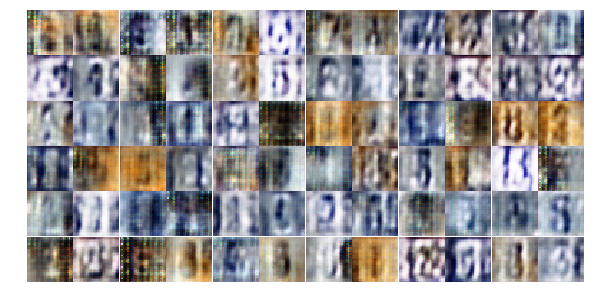

Epoch 3/25... Discriminator Loss: 1.3931... Generator Loss: 0.5873
Epoch 4/25... Discriminator Loss: 1.2157... Generator Loss: 0.8984
Epoch 4/25... Discriminator Loss: 1.3455... Generator Loss: 0.8386
Epoch 4/25... Discriminator Loss: 1.2864... Generator Loss: 0.7946
Epoch 4/25... Discriminator Loss: 1.2925... Generator Loss: 0.6756
Epoch 4/25... Discriminator Loss: 1.2633... Generator Loss: 0.7809
Epoch 4/25... Discriminator Loss: 1.1502... Generator Loss: 0.8162
Epoch 4/25... Discriminator Loss: 1.1820... Generator Loss: 0.8233
Epoch 4/25... Discriminator Loss: 1.4524... Generator Loss: 0.6792
Epoch 4/25... Discriminator Loss: 1.2974... Generator Loss: 0.7435


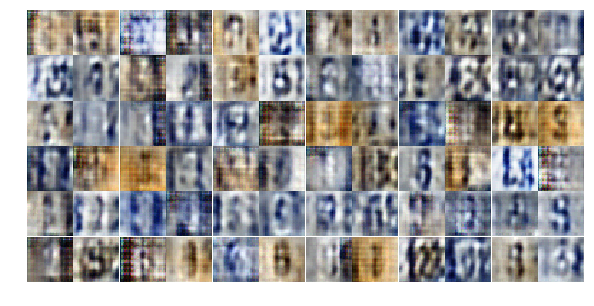

Epoch 4/25... Discriminator Loss: 1.4296... Generator Loss: 0.9336
Epoch 4/25... Discriminator Loss: 1.2661... Generator Loss: 0.7079
Epoch 4/25... Discriminator Loss: 1.3554... Generator Loss: 0.7116
Epoch 4/25... Discriminator Loss: 1.1191... Generator Loss: 0.8244
Epoch 4/25... Discriminator Loss: 1.2248... Generator Loss: 0.8283
Epoch 4/25... Discriminator Loss: 1.3349... Generator Loss: 0.6717
Epoch 4/25... Discriminator Loss: 0.8558... Generator Loss: 1.4142
Epoch 4/25... Discriminator Loss: 0.7788... Generator Loss: 1.6462
Epoch 4/25... Discriminator Loss: 1.1784... Generator Loss: 1.1639
Epoch 4/25... Discriminator Loss: 0.8596... Generator Loss: 0.9928


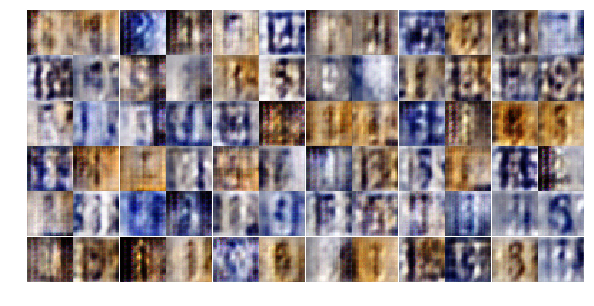

Epoch 4/25... Discriminator Loss: 1.2598... Generator Loss: 0.8589
Epoch 4/25... Discriminator Loss: 1.6154... Generator Loss: 0.5193
Epoch 4/25... Discriminator Loss: 1.1521... Generator Loss: 1.0137
Epoch 4/25... Discriminator Loss: 1.5064... Generator Loss: 0.8479
Epoch 4/25... Discriminator Loss: 1.1493... Generator Loss: 0.7122
Epoch 4/25... Discriminator Loss: 1.2308... Generator Loss: 0.7144
Epoch 4/25... Discriminator Loss: 1.4844... Generator Loss: 0.5293
Epoch 4/25... Discriminator Loss: 1.2903... Generator Loss: 0.8970
Epoch 4/25... Discriminator Loss: 1.2973... Generator Loss: 0.8787
Epoch 4/25... Discriminator Loss: 1.3433... Generator Loss: 0.8886


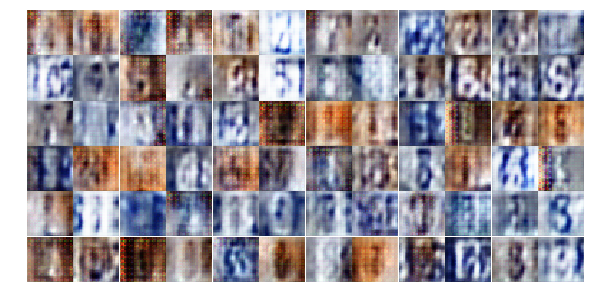

Epoch 4/25... Discriminator Loss: 1.2616... Generator Loss: 0.8280
Epoch 4/25... Discriminator Loss: 1.1904... Generator Loss: 0.9119
Epoch 4/25... Discriminator Loss: 1.2314... Generator Loss: 0.7350
Epoch 4/25... Discriminator Loss: 1.2156... Generator Loss: 0.8737
Epoch 4/25... Discriminator Loss: 1.4059... Generator Loss: 0.5057
Epoch 4/25... Discriminator Loss: 1.2342... Generator Loss: 0.8553
Epoch 4/25... Discriminator Loss: 1.1949... Generator Loss: 1.0235
Epoch 4/25... Discriminator Loss: 1.3832... Generator Loss: 0.5359
Epoch 4/25... Discriminator Loss: 1.3950... Generator Loss: 0.8371
Epoch 4/25... Discriminator Loss: 1.2109... Generator Loss: 0.8060


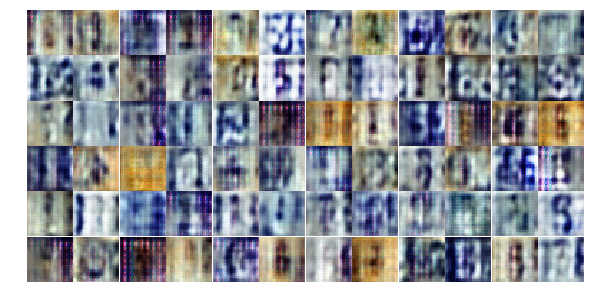

Epoch 4/25... Discriminator Loss: 1.3846... Generator Loss: 0.7312
Epoch 4/25... Discriminator Loss: 1.1197... Generator Loss: 0.9305
Epoch 4/25... Discriminator Loss: 1.1054... Generator Loss: 0.9191
Epoch 4/25... Discriminator Loss: 1.1837... Generator Loss: 0.8430
Epoch 4/25... Discriminator Loss: 1.1512... Generator Loss: 0.9622
Epoch 4/25... Discriminator Loss: 1.0674... Generator Loss: 0.7952
Epoch 4/25... Discriminator Loss: 0.8715... Generator Loss: 0.8337
Epoch 4/25... Discriminator Loss: 1.1149... Generator Loss: 1.0968
Epoch 4/25... Discriminator Loss: 0.7244... Generator Loss: 1.2007
Epoch 4/25... Discriminator Loss: 0.7636... Generator Loss: 1.5805


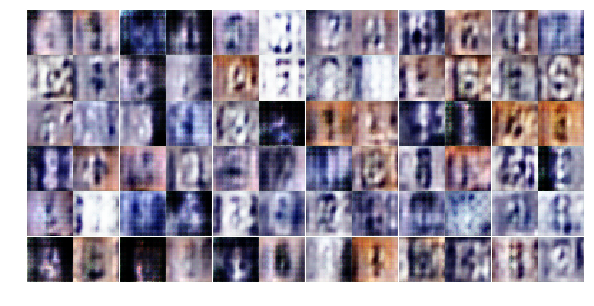

Epoch 4/25... Discriminator Loss: 1.3299... Generator Loss: 1.5817
Epoch 4/25... Discriminator Loss: 0.8002... Generator Loss: 0.8041
Epoch 4/25... Discriminator Loss: 1.0786... Generator Loss: 0.9381
Epoch 4/25... Discriminator Loss: 1.2719... Generator Loss: 0.7653
Epoch 4/25... Discriminator Loss: 1.2642... Generator Loss: 0.8051
Epoch 4/25... Discriminator Loss: 1.1848... Generator Loss: 0.7489
Epoch 4/25... Discriminator Loss: 1.0715... Generator Loss: 0.9831
Epoch 4/25... Discriminator Loss: 1.3823... Generator Loss: 0.9223
Epoch 4/25... Discriminator Loss: 1.2216... Generator Loss: 0.6531
Epoch 5/25... Discriminator Loss: 0.9275... Generator Loss: 1.3253


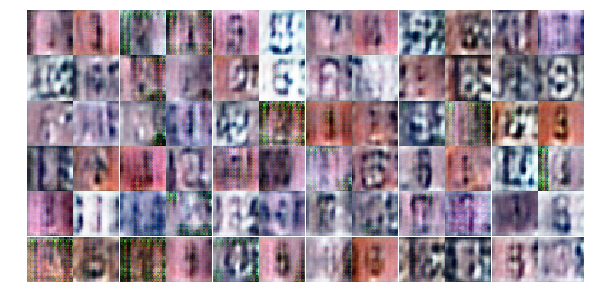

Epoch 5/25... Discriminator Loss: 1.3896... Generator Loss: 0.6979
Epoch 5/25... Discriminator Loss: 1.3699... Generator Loss: 0.6859
Epoch 5/25... Discriminator Loss: 1.2726... Generator Loss: 0.8740
Epoch 5/25... Discriminator Loss: 1.1317... Generator Loss: 0.8055
Epoch 5/25... Discriminator Loss: 1.3388... Generator Loss: 0.7335
Epoch 5/25... Discriminator Loss: 1.2542... Generator Loss: 0.7650
Epoch 5/25... Discriminator Loss: 1.3142... Generator Loss: 0.9637
Epoch 5/25... Discriminator Loss: 1.2765... Generator Loss: 0.7846
Epoch 5/25... Discriminator Loss: 1.2077... Generator Loss: 0.9746
Epoch 5/25... Discriminator Loss: 1.2226... Generator Loss: 0.9257


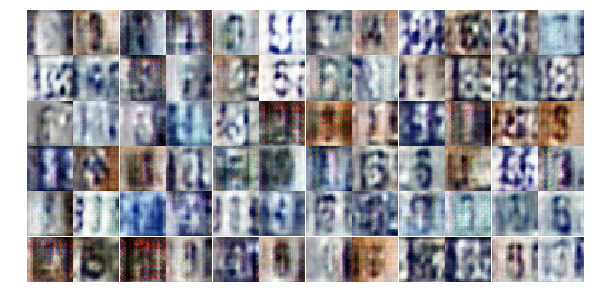

Epoch 5/25... Discriminator Loss: 1.3452... Generator Loss: 0.5952
Epoch 5/25... Discriminator Loss: 1.2218... Generator Loss: 0.8042
Epoch 5/25... Discriminator Loss: 1.3258... Generator Loss: 0.9412
Epoch 5/25... Discriminator Loss: 1.2677... Generator Loss: 0.6996
Epoch 5/25... Discriminator Loss: 1.2571... Generator Loss: 0.7548
Epoch 5/25... Discriminator Loss: 1.2922... Generator Loss: 0.7618
Epoch 5/25... Discriminator Loss: 1.2589... Generator Loss: 0.7874
Epoch 5/25... Discriminator Loss: 1.2347... Generator Loss: 0.8321
Epoch 5/25... Discriminator Loss: 0.9294... Generator Loss: 1.1349
Epoch 5/25... Discriminator Loss: 1.0935... Generator Loss: 0.9224


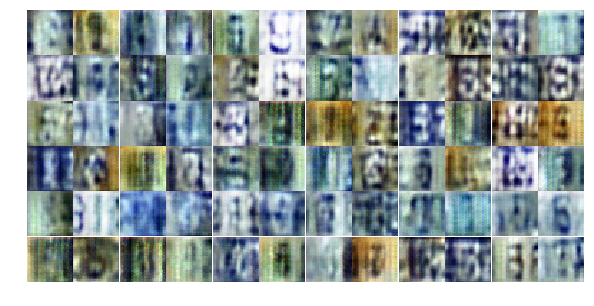

Epoch 5/25... Discriminator Loss: 1.1323... Generator Loss: 0.9062
Epoch 5/25... Discriminator Loss: 1.2952... Generator Loss: 0.7280
Epoch 5/25... Discriminator Loss: 1.4063... Generator Loss: 0.6527
Epoch 5/25... Discriminator Loss: 1.2184... Generator Loss: 0.7211
Epoch 5/25... Discriminator Loss: 1.1808... Generator Loss: 1.1774
Epoch 5/25... Discriminator Loss: 1.0889... Generator Loss: 0.9806
Epoch 5/25... Discriminator Loss: 1.3460... Generator Loss: 0.5386
Epoch 5/25... Discriminator Loss: 1.2503... Generator Loss: 0.7780
Epoch 5/25... Discriminator Loss: 1.2100... Generator Loss: 0.8111
Epoch 5/25... Discriminator Loss: 0.9721... Generator Loss: 1.0006


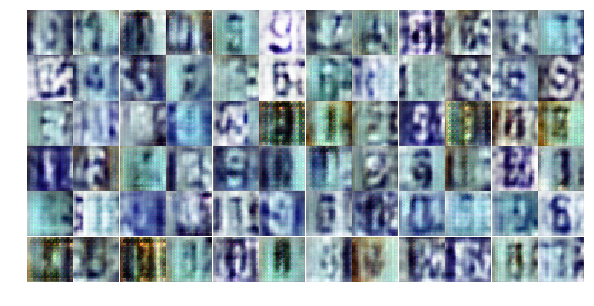

Epoch 5/25... Discriminator Loss: 1.1433... Generator Loss: 0.8503
Epoch 5/25... Discriminator Loss: 1.2266... Generator Loss: 0.8515
Epoch 5/25... Discriminator Loss: 1.2263... Generator Loss: 0.6573
Epoch 5/25... Discriminator Loss: 1.1483... Generator Loss: 0.8969
Epoch 5/25... Discriminator Loss: 1.2158... Generator Loss: 1.0998
Epoch 5/25... Discriminator Loss: 1.2639... Generator Loss: 1.4034
Epoch 5/25... Discriminator Loss: 1.3446... Generator Loss: 0.6880
Epoch 5/25... Discriminator Loss: 1.2594... Generator Loss: 0.5919
Epoch 5/25... Discriminator Loss: 1.1830... Generator Loss: 0.7148
Epoch 5/25... Discriminator Loss: 1.0759... Generator Loss: 1.0124


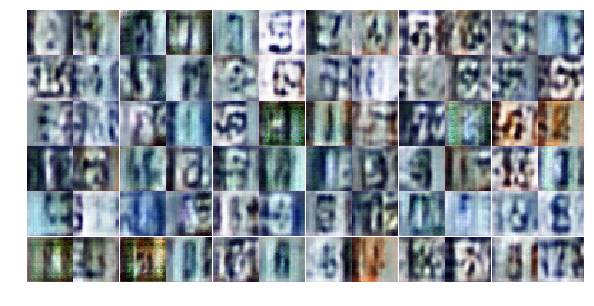

Epoch 5/25... Discriminator Loss: 0.7230... Generator Loss: 1.1382
Epoch 5/25... Discriminator Loss: 0.9921... Generator Loss: 0.7469
Epoch 5/25... Discriminator Loss: 1.0669... Generator Loss: 1.1958
Epoch 5/25... Discriminator Loss: 1.2850... Generator Loss: 0.5751
Epoch 5/25... Discriminator Loss: 1.4414... Generator Loss: 0.5043
Epoch 5/25... Discriminator Loss: 1.1925... Generator Loss: 0.4997
Epoch 5/25... Discriminator Loss: 0.8030... Generator Loss: 1.2112
Epoch 5/25... Discriminator Loss: 1.5064... Generator Loss: 0.3679
Epoch 5/25... Discriminator Loss: 0.5141... Generator Loss: 1.4529
Epoch 5/25... Discriminator Loss: 1.0671... Generator Loss: 0.6546


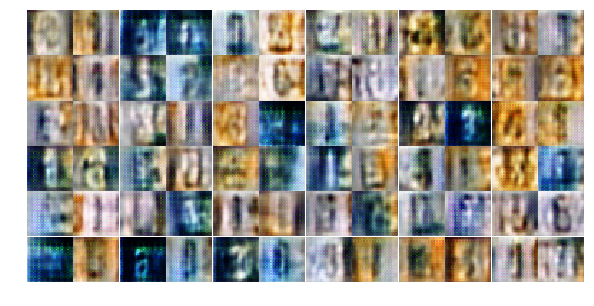

Epoch 5/25... Discriminator Loss: 1.4208... Generator Loss: 0.8563
Epoch 5/25... Discriminator Loss: 1.2561... Generator Loss: 1.0452
Epoch 5/25... Discriminator Loss: 1.0129... Generator Loss: 0.8693
Epoch 5/25... Discriminator Loss: 1.3398... Generator Loss: 0.6299
Epoch 5/25... Discriminator Loss: 1.5236... Generator Loss: 0.6682
Epoch 5/25... Discriminator Loss: 1.3980... Generator Loss: 0.8498
Epoch 6/25... Discriminator Loss: 1.1696... Generator Loss: 0.8492
Epoch 6/25... Discriminator Loss: 1.0439... Generator Loss: 0.9593
Epoch 6/25... Discriminator Loss: 1.1974... Generator Loss: 0.8177
Epoch 6/25... Discriminator Loss: 1.1473... Generator Loss: 0.8556


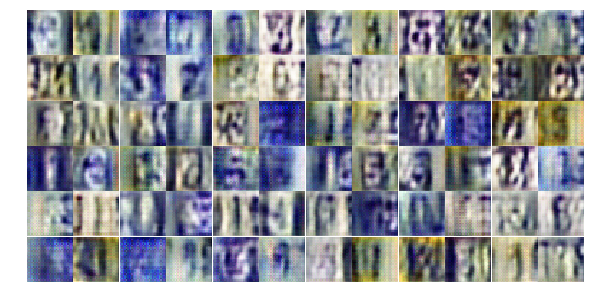

Epoch 6/25... Discriminator Loss: 1.0392... Generator Loss: 0.9597
Epoch 6/25... Discriminator Loss: 1.1706... Generator Loss: 0.8943
Epoch 6/25... Discriminator Loss: 1.3072... Generator Loss: 0.9463
Epoch 6/25... Discriminator Loss: 1.3570... Generator Loss: 0.8693
Epoch 6/25... Discriminator Loss: 0.9920... Generator Loss: 1.4648
Epoch 6/25... Discriminator Loss: 0.4602... Generator Loss: 1.8416
Epoch 6/25... Discriminator Loss: 1.2383... Generator Loss: 0.7458
Epoch 6/25... Discriminator Loss: 1.1024... Generator Loss: 0.7953
Epoch 6/25... Discriminator Loss: 1.1492... Generator Loss: 0.8680
Epoch 6/25... Discriminator Loss: 1.3349... Generator Loss: 0.8938


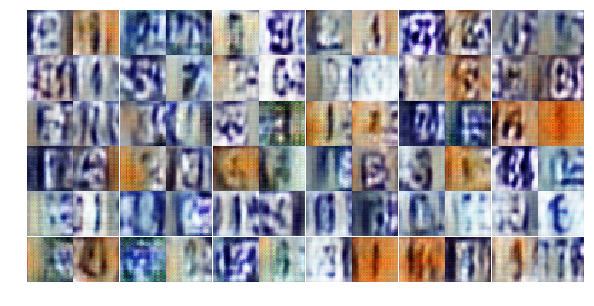

Epoch 6/25... Discriminator Loss: 1.1573... Generator Loss: 0.8800
Epoch 6/25... Discriminator Loss: 1.1580... Generator Loss: 0.6613
Epoch 6/25... Discriminator Loss: 1.4723... Generator Loss: 0.5638
Epoch 6/25... Discriminator Loss: 1.3869... Generator Loss: 0.6817
Epoch 6/25... Discriminator Loss: 1.3057... Generator Loss: 0.8153
Epoch 6/25... Discriminator Loss: 1.1246... Generator Loss: 0.9759
Epoch 6/25... Discriminator Loss: 1.2303... Generator Loss: 0.9365
Epoch 6/25... Discriminator Loss: 1.1781... Generator Loss: 0.7262
Epoch 6/25... Discriminator Loss: 1.2355... Generator Loss: 0.8555
Epoch 6/25... Discriminator Loss: 1.2295... Generator Loss: 0.6665


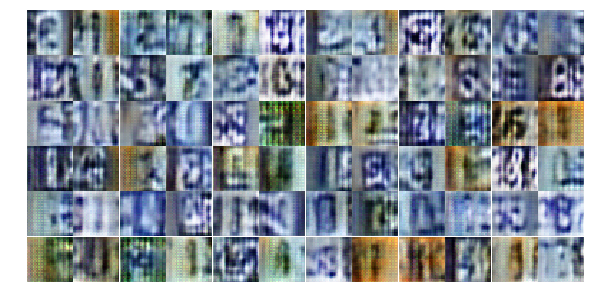

Epoch 6/25... Discriminator Loss: 1.3050... Generator Loss: 0.7064
Epoch 6/25... Discriminator Loss: 1.1393... Generator Loss: 0.8534
Epoch 6/25... Discriminator Loss: 1.1441... Generator Loss: 0.9185
Epoch 6/25... Discriminator Loss: 1.2288... Generator Loss: 0.6696
Epoch 6/25... Discriminator Loss: 1.2236... Generator Loss: 0.7435
Epoch 6/25... Discriminator Loss: 1.2412... Generator Loss: 0.6044
Epoch 6/25... Discriminator Loss: 1.3231... Generator Loss: 0.6157
Epoch 6/25... Discriminator Loss: 1.1154... Generator Loss: 1.2297
Epoch 6/25... Discriminator Loss: 1.0962... Generator Loss: 0.8115
Epoch 6/25... Discriminator Loss: 1.1622... Generator Loss: 1.0199


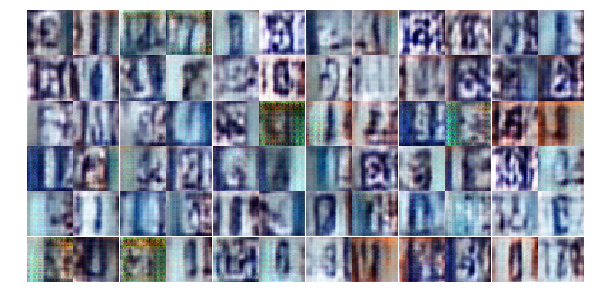

Epoch 6/25... Discriminator Loss: 1.2915... Generator Loss: 0.6534
Epoch 6/25... Discriminator Loss: 1.2228... Generator Loss: 0.9505
Epoch 6/25... Discriminator Loss: 1.2273... Generator Loss: 0.6771
Epoch 6/25... Discriminator Loss: 1.3573... Generator Loss: 0.6048
Epoch 6/25... Discriminator Loss: 1.0134... Generator Loss: 0.8868
Epoch 6/25... Discriminator Loss: 1.1440... Generator Loss: 1.0316
Epoch 6/25... Discriminator Loss: 1.2372... Generator Loss: 0.8062
Epoch 6/25... Discriminator Loss: 1.2956... Generator Loss: 0.7833
Epoch 6/25... Discriminator Loss: 1.2966... Generator Loss: 0.6578
Epoch 6/25... Discriminator Loss: 1.0748... Generator Loss: 0.9535


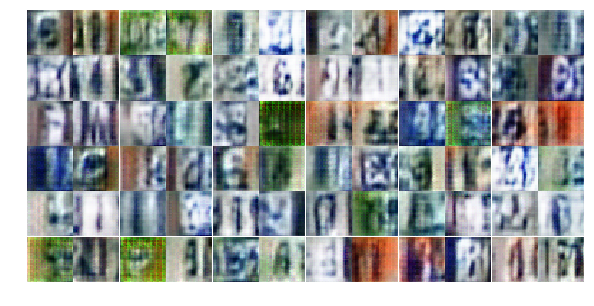

Epoch 6/25... Discriminator Loss: 1.3330... Generator Loss: 1.0471
Epoch 6/25... Discriminator Loss: 1.2396... Generator Loss: 0.7683
Epoch 6/25... Discriminator Loss: 1.3287... Generator Loss: 0.5045
Epoch 6/25... Discriminator Loss: 1.3175... Generator Loss: 0.8473
Epoch 6/25... Discriminator Loss: 1.1601... Generator Loss: 1.1414
Epoch 6/25... Discriminator Loss: 1.2295... Generator Loss: 0.6433
Epoch 6/25... Discriminator Loss: 1.1389... Generator Loss: 0.7637
Epoch 6/25... Discriminator Loss: 1.1354... Generator Loss: 0.7097
Epoch 6/25... Discriminator Loss: 1.4153... Generator Loss: 1.1247
Epoch 6/25... Discriminator Loss: 1.3708... Generator Loss: 0.5363


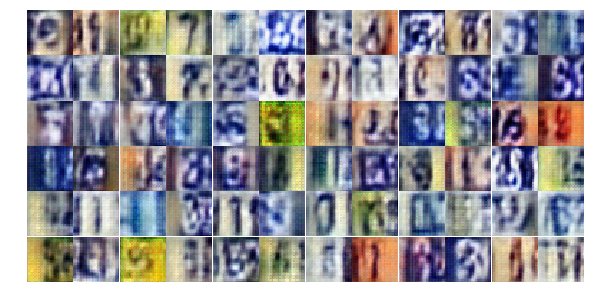

Epoch 6/25... Discriminator Loss: 1.1392... Generator Loss: 0.9788
Epoch 6/25... Discriminator Loss: 1.3529... Generator Loss: 0.9313
Epoch 6/25... Discriminator Loss: 1.2192... Generator Loss: 0.7101
Epoch 7/25... Discriminator Loss: 0.7195... Generator Loss: 1.7091
Epoch 7/25... Discriminator Loss: 0.8254... Generator Loss: 1.6939
Epoch 7/25... Discriminator Loss: 1.1466... Generator Loss: 1.3822
Epoch 7/25... Discriminator Loss: 1.2545... Generator Loss: 0.7355
Epoch 7/25... Discriminator Loss: 0.8124... Generator Loss: 0.9819
Epoch 7/25... Discriminator Loss: 1.1164... Generator Loss: 0.5932
Epoch 7/25... Discriminator Loss: 0.3633... Generator Loss: 1.8702


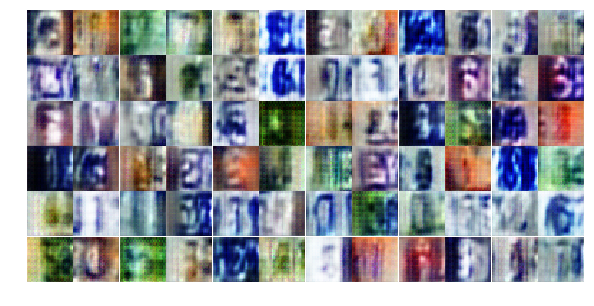

Epoch 7/25... Discriminator Loss: 0.4036... Generator Loss: 4.6269
Epoch 7/25... Discriminator Loss: 1.0990... Generator Loss: 0.8613
Epoch 7/25... Discriminator Loss: 1.0050... Generator Loss: 1.0567
Epoch 7/25... Discriminator Loss: 1.3618... Generator Loss: 0.7379
Epoch 7/25... Discriminator Loss: 1.2769... Generator Loss: 0.8114
Epoch 7/25... Discriminator Loss: 1.2120... Generator Loss: 0.7737
Epoch 7/25... Discriminator Loss: 1.5137... Generator Loss: 0.8960
Epoch 7/25... Discriminator Loss: 1.3223... Generator Loss: 0.7288
Epoch 7/25... Discriminator Loss: 1.2980... Generator Loss: 0.8659
Epoch 7/25... Discriminator Loss: 1.2267... Generator Loss: 0.9663


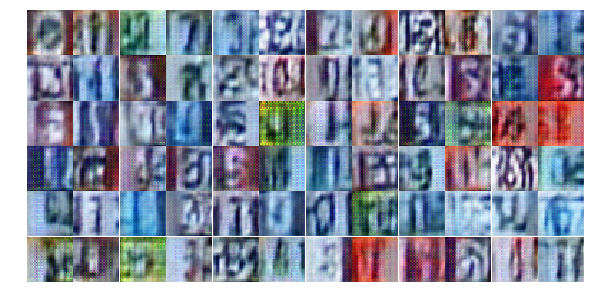

Epoch 7/25... Discriminator Loss: 1.3866... Generator Loss: 0.7285
Epoch 7/25... Discriminator Loss: 1.2917... Generator Loss: 0.8586
Epoch 7/25... Discriminator Loss: 1.1138... Generator Loss: 0.7876
Epoch 7/25... Discriminator Loss: 1.2845... Generator Loss: 1.1021
Epoch 7/25... Discriminator Loss: 1.0797... Generator Loss: 0.9022
Epoch 7/25... Discriminator Loss: 1.3132... Generator Loss: 0.7162
Epoch 7/25... Discriminator Loss: 1.3243... Generator Loss: 0.7365
Epoch 7/25... Discriminator Loss: 1.4352... Generator Loss: 0.5336
Epoch 7/25... Discriminator Loss: 1.1532... Generator Loss: 1.0608
Epoch 7/25... Discriminator Loss: 1.2077... Generator Loss: 0.7971


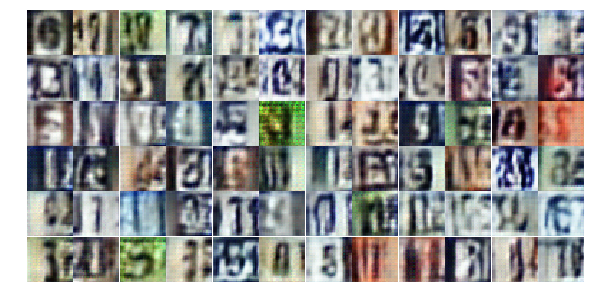

Epoch 7/25... Discriminator Loss: 1.6784... Generator Loss: 0.3610
Epoch 7/25... Discriminator Loss: 1.3303... Generator Loss: 0.5809
Epoch 7/25... Discriminator Loss: 1.2695... Generator Loss: 1.0483
Epoch 7/25... Discriminator Loss: 1.0964... Generator Loss: 0.8031
Epoch 7/25... Discriminator Loss: 1.2525... Generator Loss: 0.7651
Epoch 7/25... Discriminator Loss: 1.2058... Generator Loss: 0.8464
Epoch 7/25... Discriminator Loss: 1.3842... Generator Loss: 0.5200
Epoch 7/25... Discriminator Loss: 1.2660... Generator Loss: 0.6548
Epoch 7/25... Discriminator Loss: 1.3250... Generator Loss: 0.8777
Epoch 7/25... Discriminator Loss: 1.3761... Generator Loss: 0.5869


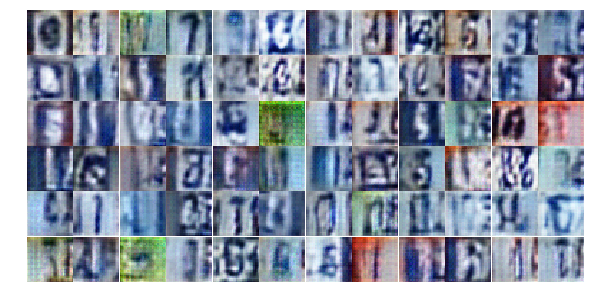

Epoch 7/25... Discriminator Loss: 1.3078... Generator Loss: 0.6817
Epoch 7/25... Discriminator Loss: 1.4600... Generator Loss: 0.5556
Epoch 7/25... Discriminator Loss: 1.4310... Generator Loss: 0.9967
Epoch 7/25... Discriminator Loss: 1.2878... Generator Loss: 0.8115
Epoch 7/25... Discriminator Loss: 1.0939... Generator Loss: 1.0313
Epoch 7/25... Discriminator Loss: 1.3199... Generator Loss: 0.6893
Epoch 7/25... Discriminator Loss: 1.3428... Generator Loss: 0.5615
Epoch 7/25... Discriminator Loss: 1.3517... Generator Loss: 0.5991
Epoch 7/25... Discriminator Loss: 1.4441... Generator Loss: 1.0405
Epoch 7/25... Discriminator Loss: 1.3172... Generator Loss: 0.6261


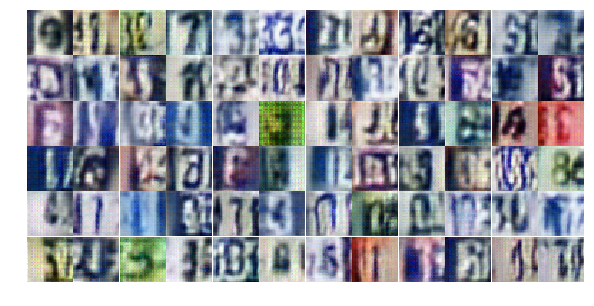

Epoch 7/25... Discriminator Loss: 1.0828... Generator Loss: 0.7786
Epoch 7/25... Discriminator Loss: 1.1726... Generator Loss: 0.8198
Epoch 7/25... Discriminator Loss: 1.3239... Generator Loss: 0.6679
Epoch 7/25... Discriminator Loss: 1.2792... Generator Loss: 0.6739
Epoch 7/25... Discriminator Loss: 1.2079... Generator Loss: 0.6965
Epoch 7/25... Discriminator Loss: 1.1753... Generator Loss: 1.0428
Epoch 7/25... Discriminator Loss: 1.4015... Generator Loss: 0.5147
Epoch 7/25... Discriminator Loss: 1.1373... Generator Loss: 0.9493
Epoch 7/25... Discriminator Loss: 1.1875... Generator Loss: 0.7430
Epoch 7/25... Discriminator Loss: 1.1439... Generator Loss: 0.7948


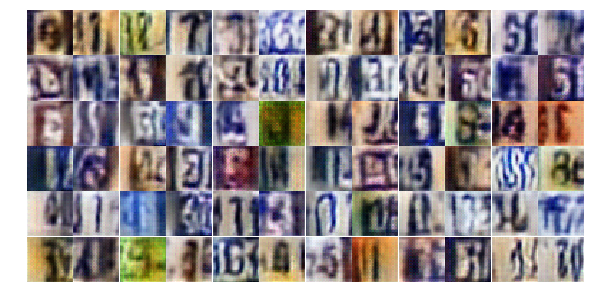

Epoch 7/25... Discriminator Loss: 1.2409... Generator Loss: 0.9476
Epoch 8/25... Discriminator Loss: 1.2930... Generator Loss: 0.5110
Epoch 8/25... Discriminator Loss: 1.1679... Generator Loss: 0.6726
Epoch 8/25... Discriminator Loss: 1.3328... Generator Loss: 0.5709
Epoch 8/25... Discriminator Loss: 1.2326... Generator Loss: 0.9438
Epoch 8/25... Discriminator Loss: 1.3339... Generator Loss: 0.7253
Epoch 8/25... Discriminator Loss: 1.3733... Generator Loss: 0.5478
Epoch 8/25... Discriminator Loss: 1.1685... Generator Loss: 0.7943
Epoch 8/25... Discriminator Loss: 1.1560... Generator Loss: 0.5685
Epoch 8/25... Discriminator Loss: 1.4189... Generator Loss: 1.0973


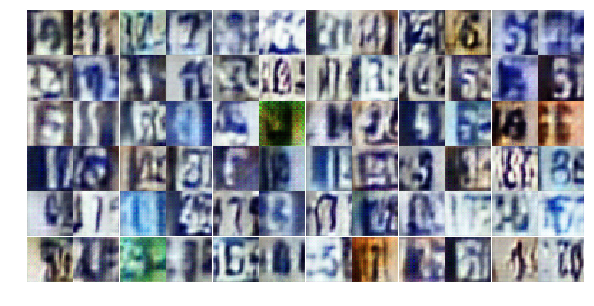

Epoch 8/25... Discriminator Loss: 1.0222... Generator Loss: 1.2843
Epoch 8/25... Discriminator Loss: 0.9406... Generator Loss: 1.2593
Epoch 8/25... Discriminator Loss: 1.2250... Generator Loss: 0.6313
Epoch 8/25... Discriminator Loss: 0.9257... Generator Loss: 0.9606
Epoch 8/25... Discriminator Loss: 1.4328... Generator Loss: 0.5547
Epoch 8/25... Discriminator Loss: 1.3325... Generator Loss: 0.8367
Epoch 8/25... Discriminator Loss: 1.2163... Generator Loss: 0.9208
Epoch 8/25... Discriminator Loss: 1.2048... Generator Loss: 1.0393
Epoch 8/25... Discriminator Loss: 1.2156... Generator Loss: 0.7254
Epoch 8/25... Discriminator Loss: 1.4890... Generator Loss: 0.4905


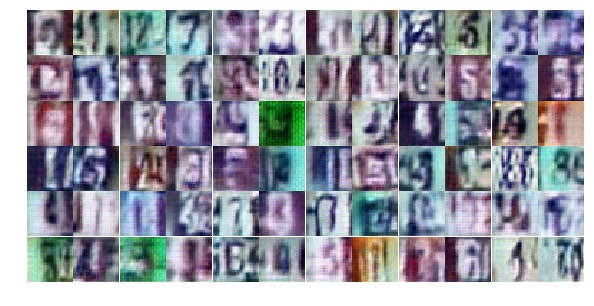

Epoch 8/25... Discriminator Loss: 0.9684... Generator Loss: 1.0465
Epoch 8/25... Discriminator Loss: 1.0534... Generator Loss: 0.9162
Epoch 8/25... Discriminator Loss: 1.0934... Generator Loss: 0.6506
Epoch 8/25... Discriminator Loss: 1.0227... Generator Loss: 1.7058
Epoch 8/25... Discriminator Loss: 1.7564... Generator Loss: 3.5311
Epoch 8/25... Discriminator Loss: 1.2166... Generator Loss: 2.3202
Epoch 8/25... Discriminator Loss: 0.3901... Generator Loss: 1.5331
Epoch 8/25... Discriminator Loss: 0.5497... Generator Loss: 2.2740
Epoch 8/25... Discriminator Loss: 0.5692... Generator Loss: 1.5043
Epoch 8/25... Discriminator Loss: 1.0048... Generator Loss: 1.1121


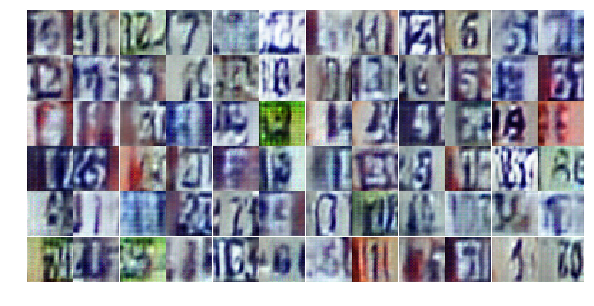

Epoch 8/25... Discriminator Loss: 1.1430... Generator Loss: 0.9181
Epoch 8/25... Discriminator Loss: 1.2311... Generator Loss: 1.0246
Epoch 8/25... Discriminator Loss: 1.3878... Generator Loss: 0.6519
Epoch 8/25... Discriminator Loss: 1.0273... Generator Loss: 0.8342
Epoch 8/25... Discriminator Loss: 1.6577... Generator Loss: 0.4046
Epoch 8/25... Discriminator Loss: 1.0991... Generator Loss: 0.8770
Epoch 8/25... Discriminator Loss: 1.1184... Generator Loss: 0.8882
Epoch 8/25... Discriminator Loss: 1.1727... Generator Loss: 0.9117
Epoch 8/25... Discriminator Loss: 1.2475... Generator Loss: 0.7207
Epoch 8/25... Discriminator Loss: 0.9433... Generator Loss: 0.9161


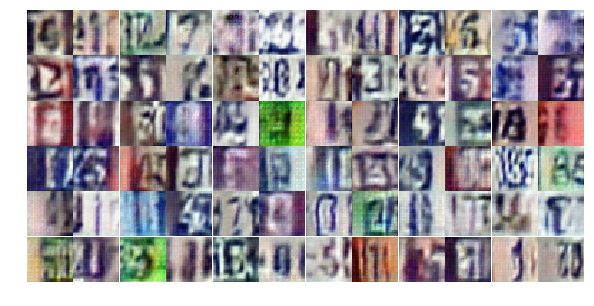

Epoch 8/25... Discriminator Loss: 0.9465... Generator Loss: 1.3990
Epoch 8/25... Discriminator Loss: 1.6894... Generator Loss: 1.3164
Epoch 8/25... Discriminator Loss: 1.2396... Generator Loss: 0.7407
Epoch 8/25... Discriminator Loss: 1.3569... Generator Loss: 0.5906
Epoch 8/25... Discriminator Loss: 1.3748... Generator Loss: 0.8347
Epoch 8/25... Discriminator Loss: 1.1964... Generator Loss: 0.7228
Epoch 8/25... Discriminator Loss: 1.0059... Generator Loss: 1.0998
Epoch 8/25... Discriminator Loss: 1.2512... Generator Loss: 0.5964
Epoch 8/25... Discriminator Loss: 1.3385... Generator Loss: 0.7269
Epoch 8/25... Discriminator Loss: 0.9843... Generator Loss: 0.6445


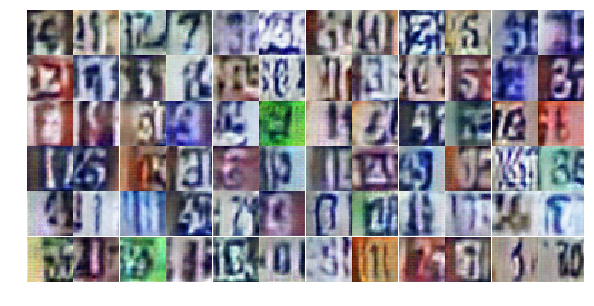

Epoch 8/25... Discriminator Loss: 0.6607... Generator Loss: 1.3636
Epoch 8/25... Discriminator Loss: 0.6712... Generator Loss: 0.8659
Epoch 8/25... Discriminator Loss: 0.8186... Generator Loss: 1.5041
Epoch 8/25... Discriminator Loss: 1.4150... Generator Loss: 0.5197
Epoch 8/25... Discriminator Loss: 1.1401... Generator Loss: 0.7293
Epoch 8/25... Discriminator Loss: 0.9411... Generator Loss: 0.5990
Epoch 8/25... Discriminator Loss: 1.3889... Generator Loss: 1.2352
Epoch 8/25... Discriminator Loss: 1.4217... Generator Loss: 1.2471
Epoch 9/25... Discriminator Loss: 1.3473... Generator Loss: 0.5971
Epoch 9/25... Discriminator Loss: 1.3857... Generator Loss: 0.5630


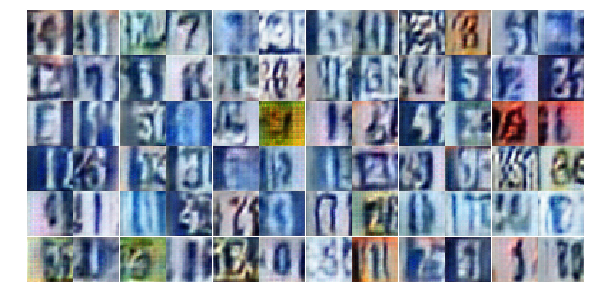

Epoch 9/25... Discriminator Loss: 1.2870... Generator Loss: 0.6670
Epoch 9/25... Discriminator Loss: 1.5050... Generator Loss: 0.9936
Epoch 9/25... Discriminator Loss: 1.1776... Generator Loss: 0.7212
Epoch 9/25... Discriminator Loss: 0.2618... Generator Loss: 2.3371
Epoch 9/25... Discriminator Loss: 1.1650... Generator Loss: 0.6523
Epoch 9/25... Discriminator Loss: 1.1071... Generator Loss: 0.7930
Epoch 9/25... Discriminator Loss: 1.0743... Generator Loss: 0.8694
Epoch 9/25... Discriminator Loss: 1.4505... Generator Loss: 0.5731
Epoch 9/25... Discriminator Loss: 0.7360... Generator Loss: 1.0475
Epoch 9/25... Discriminator Loss: 0.7505... Generator Loss: 1.5561


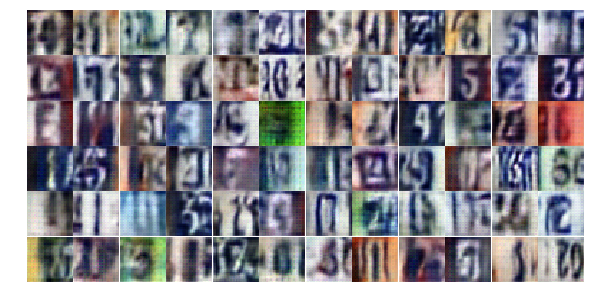

Epoch 9/25... Discriminator Loss: 1.3885... Generator Loss: 0.7862
Epoch 9/25... Discriminator Loss: 1.4922... Generator Loss: 0.8035
Epoch 9/25... Discriminator Loss: 1.2233... Generator Loss: 0.8844
Epoch 9/25... Discriminator Loss: 1.0742... Generator Loss: 0.8852
Epoch 9/25... Discriminator Loss: 0.8189... Generator Loss: 0.8912
Epoch 9/25... Discriminator Loss: 1.2139... Generator Loss: 0.6934
Epoch 9/25... Discriminator Loss: 2.5964... Generator Loss: 0.0984
Epoch 9/25... Discriminator Loss: 1.2277... Generator Loss: 0.6524
Epoch 9/25... Discriminator Loss: 1.0899... Generator Loss: 0.9125
Epoch 9/25... Discriminator Loss: 1.3149... Generator Loss: 0.6282


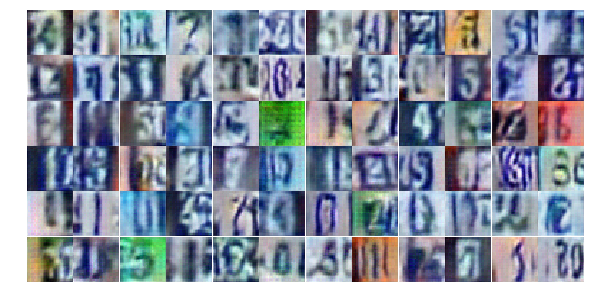

Epoch 9/25... Discriminator Loss: 0.7988... Generator Loss: 0.8402
Epoch 9/25... Discriminator Loss: 1.2414... Generator Loss: 0.8484
Epoch 9/25... Discriminator Loss: 1.3079... Generator Loss: 0.6027
Epoch 9/25... Discriminator Loss: 1.3942... Generator Loss: 0.5373
Epoch 9/25... Discriminator Loss: 1.3174... Generator Loss: 1.1242
Epoch 9/25... Discriminator Loss: 1.0943... Generator Loss: 0.7073
Epoch 9/25... Discriminator Loss: 0.7908... Generator Loss: 0.8619
Epoch 9/25... Discriminator Loss: 2.2316... Generator Loss: 1.9889
Epoch 9/25... Discriminator Loss: 1.0070... Generator Loss: 0.9970
Epoch 9/25... Discriminator Loss: 1.1982... Generator Loss: 0.8568


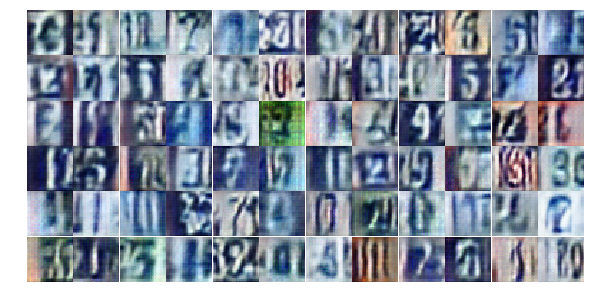

Epoch 9/25... Discriminator Loss: 1.2215... Generator Loss: 1.0024
Epoch 9/25... Discriminator Loss: 1.0960... Generator Loss: 0.8190
Epoch 9/25... Discriminator Loss: 1.4374... Generator Loss: 0.7249
Epoch 9/25... Discriminator Loss: 1.3325... Generator Loss: 0.7821
Epoch 9/25... Discriminator Loss: 1.0229... Generator Loss: 0.8068
Epoch 9/25... Discriminator Loss: 1.0172... Generator Loss: 0.9964
Epoch 9/25... Discriminator Loss: 0.9831... Generator Loss: 0.6005
Epoch 9/25... Discriminator Loss: 0.3823... Generator Loss: 5.0472
Epoch 9/25... Discriminator Loss: 0.0703... Generator Loss: 3.1254
Epoch 9/25... Discriminator Loss: 1.0578... Generator Loss: 1.3338


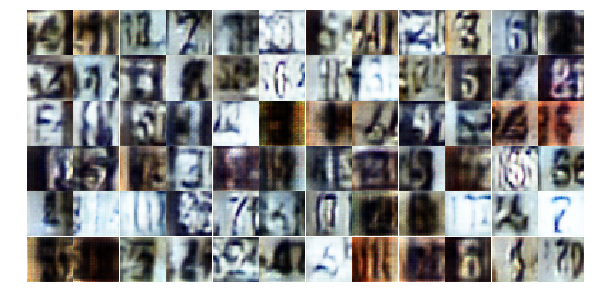

Epoch 9/25... Discriminator Loss: 0.6190... Generator Loss: 1.2704
Epoch 9/25... Discriminator Loss: 0.0694... Generator Loss: 3.0732
Epoch 9/25... Discriminator Loss: 0.7393... Generator Loss: 1.3332
Epoch 9/25... Discriminator Loss: 1.6340... Generator Loss: 1.4031
Epoch 9/25... Discriminator Loss: 1.1665... Generator Loss: 0.9781
Epoch 9/25... Discriminator Loss: 1.0461... Generator Loss: 0.8886
Epoch 9/25... Discriminator Loss: 1.1748... Generator Loss: 0.7585
Epoch 9/25... Discriminator Loss: 1.5952... Generator Loss: 0.3047
Epoch 9/25... Discriminator Loss: 1.2227... Generator Loss: 0.7599
Epoch 9/25... Discriminator Loss: 1.1008... Generator Loss: 0.9392


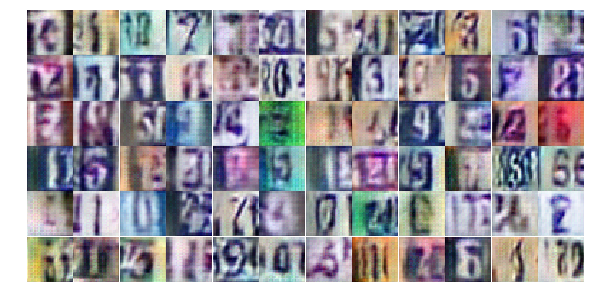

Epoch 9/25... Discriminator Loss: 1.1352... Generator Loss: 0.6211
Epoch 9/25... Discriminator Loss: 1.2320... Generator Loss: 0.7292
Epoch 9/25... Discriminator Loss: 1.3138... Generator Loss: 0.6533
Epoch 9/25... Discriminator Loss: 1.2693... Generator Loss: 0.7305
Epoch 9/25... Discriminator Loss: 1.2087... Generator Loss: 1.0143
Epoch 10/25... Discriminator Loss: 1.3211... Generator Loss: 0.7305
Epoch 10/25... Discriminator Loss: 1.2582... Generator Loss: 0.6829
Epoch 10/25... Discriminator Loss: 1.2400... Generator Loss: 0.6840
Epoch 10/25... Discriminator Loss: 1.2803... Generator Loss: 0.7055
Epoch 10/25... Discriminator Loss: 1.3381... Generator Loss: 0.5582


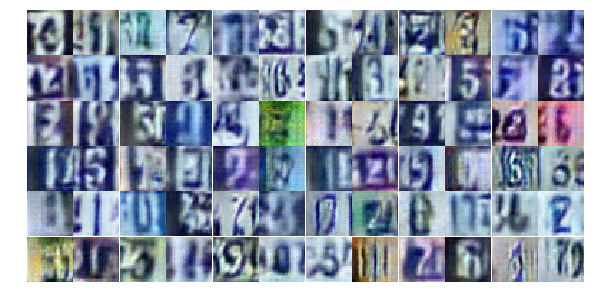

Epoch 10/25... Discriminator Loss: 1.2721... Generator Loss: 0.8764
Epoch 10/25... Discriminator Loss: 1.1468... Generator Loss: 0.7845
Epoch 10/25... Discriminator Loss: 1.0668... Generator Loss: 0.8285
Epoch 10/25... Discriminator Loss: 1.2046... Generator Loss: 0.7611
Epoch 10/25... Discriminator Loss: 1.0441... Generator Loss: 0.9237
Epoch 10/25... Discriminator Loss: 1.0239... Generator Loss: 0.7699
Epoch 10/25... Discriminator Loss: 1.0523... Generator Loss: 1.1147
Epoch 10/25... Discriminator Loss: 1.3401... Generator Loss: 0.7647
Epoch 10/25... Discriminator Loss: 0.4565... Generator Loss: 1.8435
Epoch 10/25... Discriminator Loss: 0.0552... Generator Loss: 3.3407


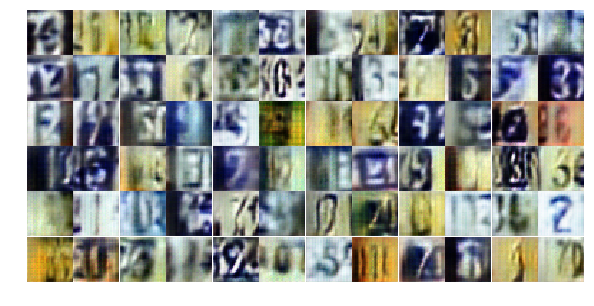

Epoch 10/25... Discriminator Loss: 0.2402... Generator Loss: 1.8480
Epoch 10/25... Discriminator Loss: 1.3063... Generator Loss: 2.0376
Epoch 10/25... Discriminator Loss: 0.9170... Generator Loss: 1.2085
Epoch 10/25... Discriminator Loss: 0.3038... Generator Loss: 1.5199
Epoch 10/25... Discriminator Loss: 1.1112... Generator Loss: 0.8413
Epoch 10/25... Discriminator Loss: 1.1180... Generator Loss: 0.8926
Epoch 10/25... Discriminator Loss: 1.3143... Generator Loss: 0.5081
Epoch 10/25... Discriminator Loss: 1.0146... Generator Loss: 0.9455
Epoch 10/25... Discriminator Loss: 1.1264... Generator Loss: 0.8005
Epoch 10/25... Discriminator Loss: 0.9854... Generator Loss: 0.9756


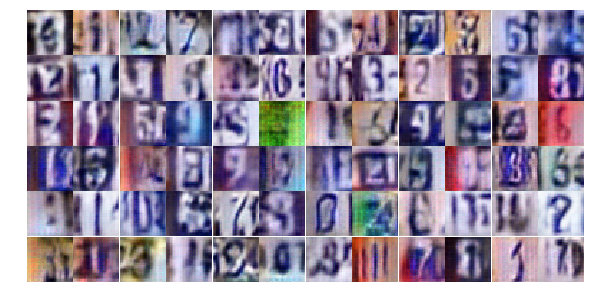

Epoch 10/25... Discriminator Loss: 0.3928... Generator Loss: 1.5929
Epoch 10/25... Discriminator Loss: 0.9364... Generator Loss: 0.7214
Epoch 10/25... Discriminator Loss: 0.9938... Generator Loss: 1.2422
Epoch 10/25... Discriminator Loss: 1.0312... Generator Loss: 0.9231
Epoch 10/25... Discriminator Loss: 0.7761... Generator Loss: 0.8546
Epoch 10/25... Discriminator Loss: 1.1178... Generator Loss: 0.7207
Epoch 10/25... Discriminator Loss: 0.6380... Generator Loss: 1.0336
Epoch 10/25... Discriminator Loss: 1.1876... Generator Loss: 1.4565
Epoch 10/25... Discriminator Loss: 1.0310... Generator Loss: 0.8484
Epoch 10/25... Discriminator Loss: 1.2128... Generator Loss: 0.8093


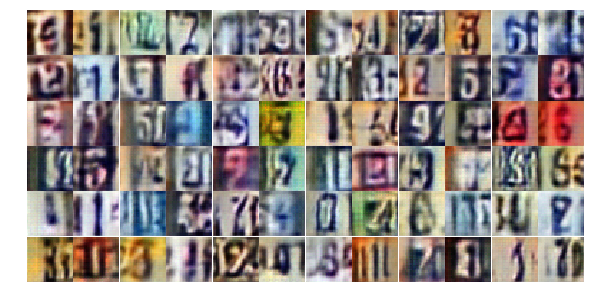

Epoch 10/25... Discriminator Loss: 1.2506... Generator Loss: 0.7070
Epoch 10/25... Discriminator Loss: 0.8542... Generator Loss: 2.9304
Epoch 10/25... Discriminator Loss: 0.5666... Generator Loss: 3.0340
Epoch 10/25... Discriminator Loss: 2.3253... Generator Loss: 2.8048
Epoch 10/25... Discriminator Loss: 0.9924... Generator Loss: 0.9065
Epoch 10/25... Discriminator Loss: 1.5165... Generator Loss: 0.5136
Epoch 10/25... Discriminator Loss: 1.0149... Generator Loss: 0.8787
Epoch 10/25... Discriminator Loss: 1.1872... Generator Loss: 0.7995
Epoch 10/25... Discriminator Loss: 1.1595... Generator Loss: 0.6164
Epoch 10/25... Discriminator Loss: 1.1318... Generator Loss: 1.0120


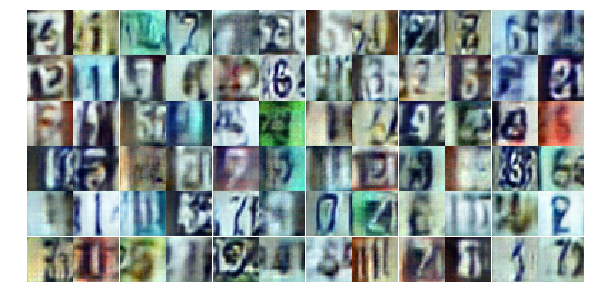

Epoch 10/25... Discriminator Loss: 2.3086... Generator Loss: 1.7626
Epoch 10/25... Discriminator Loss: 1.3999... Generator Loss: 0.6587
Epoch 10/25... Discriminator Loss: 1.0517... Generator Loss: 1.0392
Epoch 10/25... Discriminator Loss: 1.2377... Generator Loss: 0.4717
Epoch 10/25... Discriminator Loss: 0.5771... Generator Loss: 2.5247
Epoch 10/25... Discriminator Loss: 3.1558... Generator Loss: 0.0721
Epoch 10/25... Discriminator Loss: 1.2354... Generator Loss: 0.9467
Epoch 10/25... Discriminator Loss: 1.3717... Generator Loss: 0.6494
Epoch 10/25... Discriminator Loss: 1.1286... Generator Loss: 1.0156
Epoch 10/25... Discriminator Loss: 1.0987... Generator Loss: 0.8548


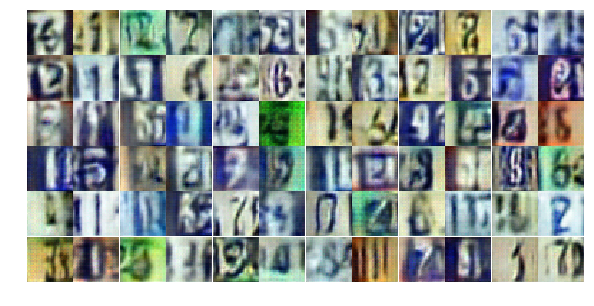

Epoch 10/25... Discriminator Loss: 1.0725... Generator Loss: 0.7064
Epoch 10/25... Discriminator Loss: 1.0756... Generator Loss: 2.1452
Epoch 10/25... Discriminator Loss: 0.6116... Generator Loss: 2.1853
Epoch 11/25... Discriminator Loss: 0.8374... Generator Loss: 0.6889
Epoch 11/25... Discriminator Loss: 0.2835... Generator Loss: 1.7285
Epoch 11/25... Discriminator Loss: 0.0462... Generator Loss: 3.5246
Epoch 11/25... Discriminator Loss: 0.2709... Generator Loss: 4.4909
Epoch 11/25... Discriminator Loss: 0.5670... Generator Loss: 1.3430
Epoch 11/25... Discriminator Loss: 1.6173... Generator Loss: 2.5434
Epoch 11/25... Discriminator Loss: 1.2383... Generator Loss: 0.5135


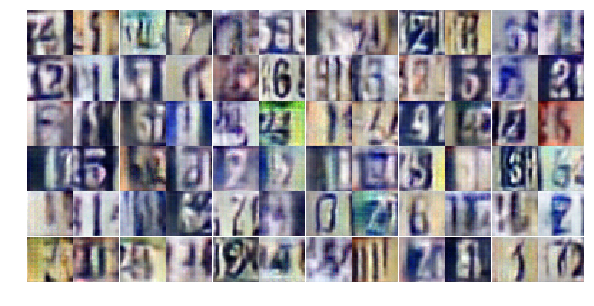

Epoch 11/25... Discriminator Loss: 1.2488... Generator Loss: 0.8429
Epoch 11/25... Discriminator Loss: 1.0858... Generator Loss: 1.1052
Epoch 11/25... Discriminator Loss: 0.9413... Generator Loss: 0.9877
Epoch 11/25... Discriminator Loss: 1.0237... Generator Loss: 0.9918
Epoch 11/25... Discriminator Loss: 0.9971... Generator Loss: 0.9399
Epoch 11/25... Discriminator Loss: 1.1036... Generator Loss: 0.7499
Epoch 11/25... Discriminator Loss: 0.9703... Generator Loss: 0.9807
Epoch 11/25... Discriminator Loss: 0.8103... Generator Loss: 1.3240
Epoch 11/25... Discriminator Loss: 1.2394... Generator Loss: 0.5529
Epoch 11/25... Discriminator Loss: 1.4419... Generator Loss: 0.4304


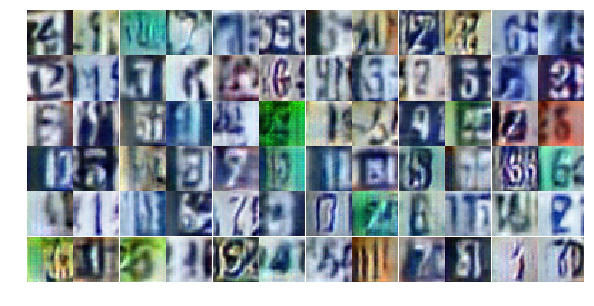

Epoch 11/25... Discriminator Loss: 1.1802... Generator Loss: 0.6306
Epoch 11/25... Discriminator Loss: 0.6316... Generator Loss: 2.7047
Epoch 11/25... Discriminator Loss: 0.9418... Generator Loss: 0.7076
Epoch 11/25... Discriminator Loss: 1.1652... Generator Loss: 1.2939
Epoch 11/25... Discriminator Loss: 0.4311... Generator Loss: 1.7918
Epoch 11/25... Discriminator Loss: 1.0015... Generator Loss: 0.6981
Epoch 11/25... Discriminator Loss: 0.4748... Generator Loss: 2.1346
Epoch 11/25... Discriminator Loss: 0.5647... Generator Loss: 1.2313
Epoch 11/25... Discriminator Loss: 0.7226... Generator Loss: 0.9516
Epoch 11/25... Discriminator Loss: 2.1097... Generator Loss: 4.5661


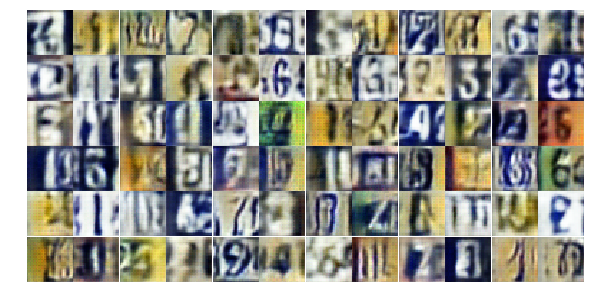

Epoch 11/25... Discriminator Loss: 0.9802... Generator Loss: 1.1400
Epoch 11/25... Discriminator Loss: 3.7004... Generator Loss: 4.8319
Epoch 11/25... Discriminator Loss: 1.1778... Generator Loss: 0.8157
Epoch 11/25... Discriminator Loss: 2.9625... Generator Loss: 0.0838
Epoch 11/25... Discriminator Loss: 1.3053... Generator Loss: 0.5310
Epoch 11/25... Discriminator Loss: 1.2680... Generator Loss: 0.8937
Epoch 11/25... Discriminator Loss: 1.3008... Generator Loss: 0.6089
Epoch 11/25... Discriminator Loss: 1.1791... Generator Loss: 0.7246
Epoch 11/25... Discriminator Loss: 1.1173... Generator Loss: 0.9340
Epoch 11/25... Discriminator Loss: 1.3189... Generator Loss: 0.6162


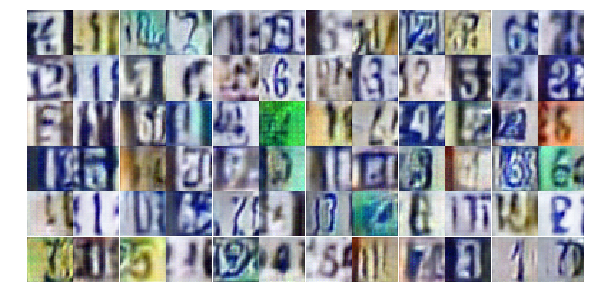

Epoch 11/25... Discriminator Loss: 1.1799... Generator Loss: 0.7840
Epoch 11/25... Discriminator Loss: 1.1076... Generator Loss: 0.7688
Epoch 11/25... Discriminator Loss: 1.3124... Generator Loss: 0.7445
Epoch 11/25... Discriminator Loss: 1.4124... Generator Loss: 0.6495
Epoch 11/25... Discriminator Loss: 1.1692... Generator Loss: 0.6511
Epoch 11/25... Discriminator Loss: 1.1678... Generator Loss: 0.9929
Epoch 11/25... Discriminator Loss: 0.9457... Generator Loss: 0.9357
Epoch 11/25... Discriminator Loss: 1.1300... Generator Loss: 0.7002
Epoch 11/25... Discriminator Loss: 1.3081... Generator Loss: 0.5691
Epoch 11/25... Discriminator Loss: 1.1500... Generator Loss: 0.7205


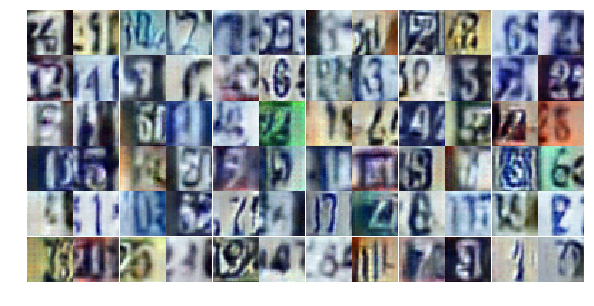

Epoch 11/25... Discriminator Loss: 1.2298... Generator Loss: 0.5576
Epoch 11/25... Discriminator Loss: 1.0405... Generator Loss: 0.9151
Epoch 11/25... Discriminator Loss: 1.2700... Generator Loss: 0.6755
Epoch 11/25... Discriminator Loss: 1.0466... Generator Loss: 0.8411
Epoch 11/25... Discriminator Loss: 1.2425... Generator Loss: 0.5533
Epoch 11/25... Discriminator Loss: 1.0107... Generator Loss: 1.0026
Epoch 11/25... Discriminator Loss: 1.2342... Generator Loss: 0.6699
Epoch 11/25... Discriminator Loss: 1.0550... Generator Loss: 1.0885
Epoch 11/25... Discriminator Loss: 1.1532... Generator Loss: 0.6632
Epoch 11/25... Discriminator Loss: 1.0604... Generator Loss: 0.8682


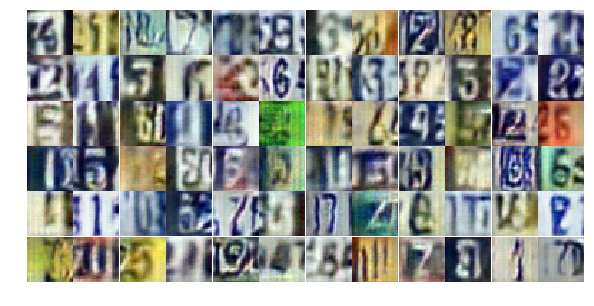

Epoch 12/25... Discriminator Loss: 1.3753... Generator Loss: 1.0648
Epoch 12/25... Discriminator Loss: 1.0784... Generator Loss: 0.9006
Epoch 12/25... Discriminator Loss: 1.2296... Generator Loss: 0.7704
Epoch 12/25... Discriminator Loss: 1.0913... Generator Loss: 1.0935
Epoch 12/25... Discriminator Loss: 0.9424... Generator Loss: 1.0997
Epoch 12/25... Discriminator Loss: 1.2975... Generator Loss: 0.4832
Epoch 12/25... Discriminator Loss: 1.1042... Generator Loss: 0.8874
Epoch 12/25... Discriminator Loss: 1.1032... Generator Loss: 0.8214
Epoch 12/25... Discriminator Loss: 1.0374... Generator Loss: 0.8720
Epoch 12/25... Discriminator Loss: 1.2896... Generator Loss: 0.5248


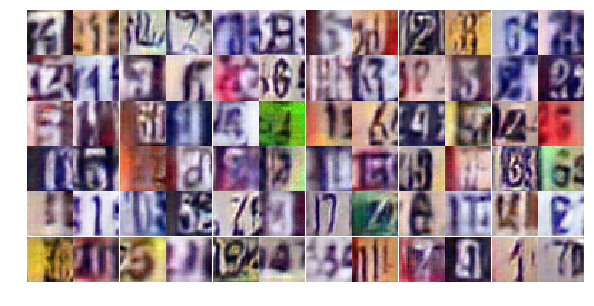

Epoch 12/25... Discriminator Loss: 1.2136... Generator Loss: 0.8449
Epoch 12/25... Discriminator Loss: 1.2750... Generator Loss: 0.5658
Epoch 12/25... Discriminator Loss: 0.6929... Generator Loss: 1.2863
Epoch 12/25... Discriminator Loss: 0.9920... Generator Loss: 1.4582
Epoch 12/25... Discriminator Loss: 1.8786... Generator Loss: 0.2671
Epoch 12/25... Discriminator Loss: 0.8202... Generator Loss: 2.2498
Epoch 12/25... Discriminator Loss: 0.3250... Generator Loss: 1.5424
Epoch 12/25... Discriminator Loss: 1.0777... Generator Loss: 1.2130
Epoch 12/25... Discriminator Loss: 0.9708... Generator Loss: 1.2910
Epoch 12/25... Discriminator Loss: 1.1394... Generator Loss: 0.5961


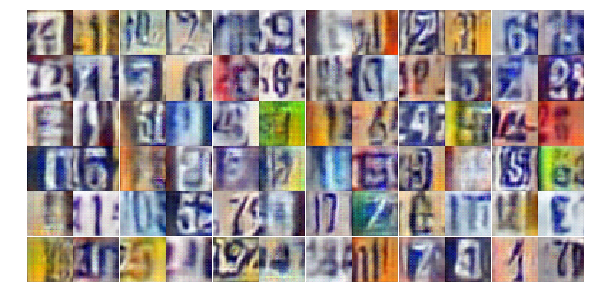

Epoch 12/25... Discriminator Loss: 0.6966... Generator Loss: 1.6412
Epoch 12/25... Discriminator Loss: 1.4940... Generator Loss: 0.5779
Epoch 12/25... Discriminator Loss: 0.9600... Generator Loss: 0.6475
Epoch 12/25... Discriminator Loss: 1.3091... Generator Loss: 0.4955
Epoch 12/25... Discriminator Loss: 0.8889... Generator Loss: 1.0462
Epoch 12/25... Discriminator Loss: 0.2292... Generator Loss: 2.0314
Epoch 12/25... Discriminator Loss: 0.1493... Generator Loss: 2.9328
Epoch 12/25... Discriminator Loss: 0.0810... Generator Loss: 3.0592
Epoch 12/25... Discriminator Loss: 0.4101... Generator Loss: 1.6106
Epoch 12/25... Discriminator Loss: 0.0302... Generator Loss: 4.2673


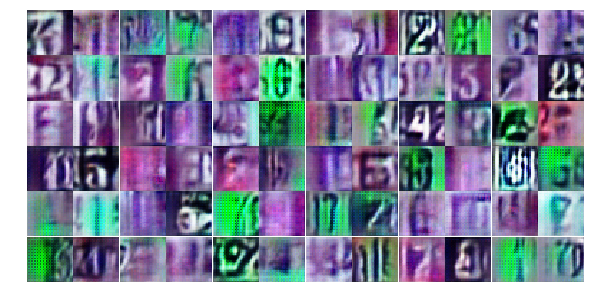

Epoch 12/25... Discriminator Loss: 0.1099... Generator Loss: 2.5384
Epoch 12/25... Discriminator Loss: 0.0259... Generator Loss: 4.3603
Epoch 12/25... Discriminator Loss: 0.0462... Generator Loss: 3.8462
Epoch 12/25... Discriminator Loss: 0.0153... Generator Loss: 5.2567
Epoch 12/25... Discriminator Loss: 0.0289... Generator Loss: 5.1112
Epoch 12/25... Discriminator Loss: 0.0073... Generator Loss: 6.1008
Epoch 12/25... Discriminator Loss: 0.0224... Generator Loss: 4.0269
Epoch 12/25... Discriminator Loss: 0.0169... Generator Loss: 4.6777
Epoch 12/25... Discriminator Loss: 0.0078... Generator Loss: 5.7922
Epoch 12/25... Discriminator Loss: 0.0093... Generator Loss: 5.1449


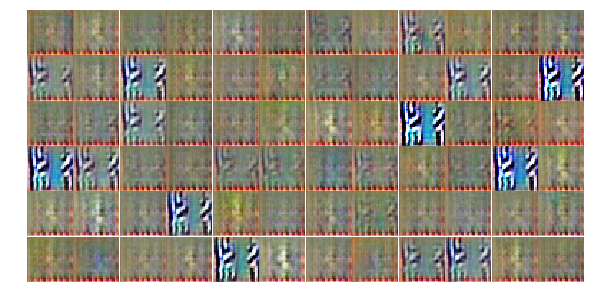

Epoch 12/25... Discriminator Loss: 0.0022... Generator Loss: 7.7167
Epoch 12/25... Discriminator Loss: 0.0122... Generator Loss: 4.9939
Epoch 12/25... Discriminator Loss: 0.0026... Generator Loss: 6.8497
Epoch 12/25... Discriminator Loss: 0.0057... Generator Loss: 8.1789
Epoch 12/25... Discriminator Loss: 0.2477... Generator Loss: 2.0447
Epoch 12/25... Discriminator Loss: 0.0034... Generator Loss: 6.2504
Epoch 12/25... Discriminator Loss: 0.0045... Generator Loss: 14.3755
Epoch 12/25... Discriminator Loss: 0.0246... Generator Loss: 4.1148
Epoch 12/25... Discriminator Loss: 0.1692... Generator Loss: 6.2591
Epoch 12/25... Discriminator Loss: 1.4908... Generator Loss: 0.8815


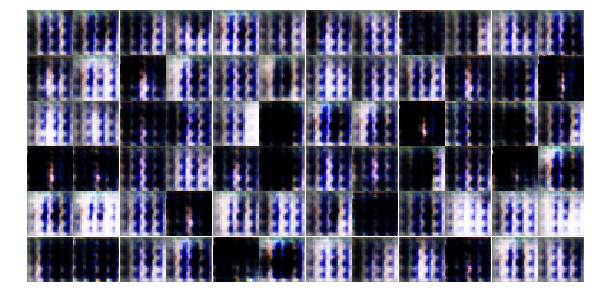

Epoch 12/25... Discriminator Loss: 0.7856... Generator Loss: 1.1054
Epoch 12/25... Discriminator Loss: 0.3224... Generator Loss: 1.8885
Epoch 12/25... Discriminator Loss: 0.5194... Generator Loss: 3.6448
Epoch 12/25... Discriminator Loss: 0.4993... Generator Loss: 1.7490
Epoch 12/25... Discriminator Loss: 0.6002... Generator Loss: 1.2671
Epoch 12/25... Discriminator Loss: 0.3378... Generator Loss: 1.9861
Epoch 12/25... Discriminator Loss: 0.6870... Generator Loss: 1.1060
Epoch 13/25... Discriminator Loss: 0.4824... Generator Loss: 1.5138
Epoch 13/25... Discriminator Loss: 0.3613... Generator Loss: 2.7683
Epoch 13/25... Discriminator Loss: 0.4067... Generator Loss: 1.9592


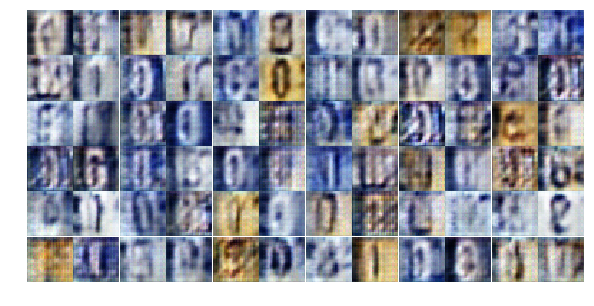

Epoch 13/25... Discriminator Loss: 0.2823... Generator Loss: 2.0983
Epoch 13/25... Discriminator Loss: 0.3985... Generator Loss: 2.5767
Epoch 13/25... Discriminator Loss: 0.8191... Generator Loss: 1.2088
Epoch 13/25... Discriminator Loss: 0.4782... Generator Loss: 1.4490
Epoch 13/25... Discriminator Loss: 0.3242... Generator Loss: 3.7244
Epoch 13/25... Discriminator Loss: 0.2941... Generator Loss: 2.4164
Epoch 13/25... Discriminator Loss: 0.4858... Generator Loss: 2.5504
Epoch 13/25... Discriminator Loss: 1.2839... Generator Loss: 4.6042
Epoch 13/25... Discriminator Loss: 0.5130... Generator Loss: 1.4517
Epoch 13/25... Discriminator Loss: 0.4452... Generator Loss: 2.1319


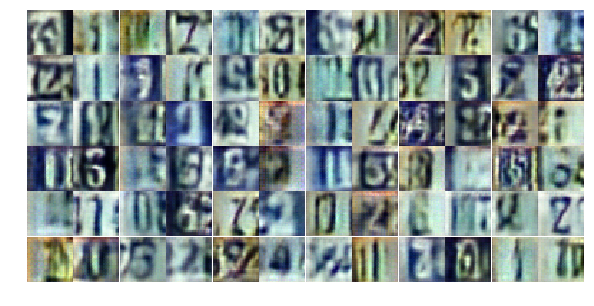

Epoch 13/25... Discriminator Loss: 0.6909... Generator Loss: 1.2302
Epoch 13/25... Discriminator Loss: 0.7713... Generator Loss: 1.0530
Epoch 13/25... Discriminator Loss: 1.2228... Generator Loss: 0.6021
Epoch 13/25... Discriminator Loss: 0.5815... Generator Loss: 1.6666
Epoch 13/25... Discriminator Loss: 0.6929... Generator Loss: 1.2016
Epoch 13/25... Discriminator Loss: 0.8761... Generator Loss: 0.9310
Epoch 13/25... Discriminator Loss: 1.2569... Generator Loss: 0.6778
Epoch 13/25... Discriminator Loss: 0.9560... Generator Loss: 1.1090
Epoch 13/25... Discriminator Loss: 0.7895... Generator Loss: 1.5448
Epoch 13/25... Discriminator Loss: 0.9193... Generator Loss: 1.0006


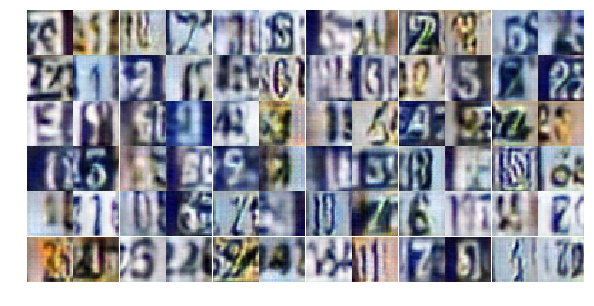

Epoch 13/25... Discriminator Loss: 0.8730... Generator Loss: 0.8489
Epoch 13/25... Discriminator Loss: 1.3223... Generator Loss: 0.6333
Epoch 13/25... Discriminator Loss: 1.2876... Generator Loss: 1.0368
Epoch 13/25... Discriminator Loss: 0.8222... Generator Loss: 1.3647
Epoch 13/25... Discriminator Loss: 0.8558... Generator Loss: 1.1222
Epoch 13/25... Discriminator Loss: 1.7928... Generator Loss: 0.3004
Epoch 13/25... Discriminator Loss: 1.3088... Generator Loss: 0.7176
Epoch 13/25... Discriminator Loss: 0.9884... Generator Loss: 0.8992
Epoch 13/25... Discriminator Loss: 0.9305... Generator Loss: 0.8929
Epoch 13/25... Discriminator Loss: 0.7221... Generator Loss: 1.2393


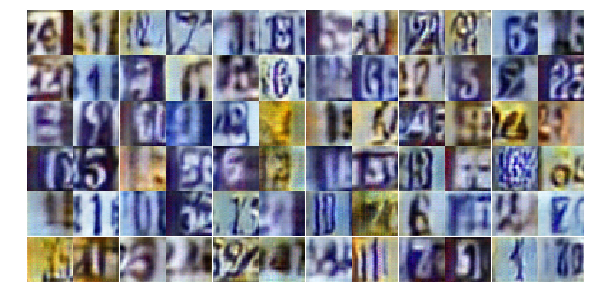

Epoch 13/25... Discriminator Loss: 0.8510... Generator Loss: 0.8333
Epoch 13/25... Discriminator Loss: 0.9114... Generator Loss: 0.8700
Epoch 13/25... Discriminator Loss: 0.5134... Generator Loss: 1.2617
Epoch 13/25... Discriminator Loss: 3.0447... Generator Loss: 1.9769
Epoch 13/25... Discriminator Loss: 1.0641... Generator Loss: 0.8763
Epoch 13/25... Discriminator Loss: 1.0304... Generator Loss: 0.9110
Epoch 13/25... Discriminator Loss: 1.1998... Generator Loss: 1.5867
Epoch 13/25... Discriminator Loss: 1.8428... Generator Loss: 0.2655
Epoch 13/25... Discriminator Loss: 0.9667... Generator Loss: 1.0347
Epoch 13/25... Discriminator Loss: 1.2749... Generator Loss: 0.6016


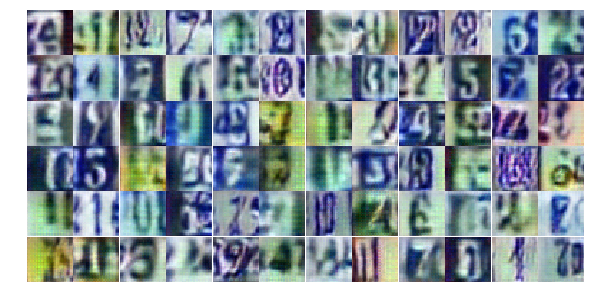

Epoch 13/25... Discriminator Loss: 0.9192... Generator Loss: 1.1332
Epoch 13/25... Discriminator Loss: 1.1199... Generator Loss: 0.8178
Epoch 13/25... Discriminator Loss: 1.1754... Generator Loss: 0.6646
Epoch 13/25... Discriminator Loss: 0.9320... Generator Loss: 0.9335
Epoch 13/25... Discriminator Loss: 1.1975... Generator Loss: 0.7231
Epoch 13/25... Discriminator Loss: 1.2460... Generator Loss: 0.7510
Epoch 13/25... Discriminator Loss: 1.3771... Generator Loss: 0.5195
Epoch 13/25... Discriminator Loss: 0.9548... Generator Loss: 0.8590
Epoch 13/25... Discriminator Loss: 0.9440... Generator Loss: 0.8411
Epoch 13/25... Discriminator Loss: 1.2947... Generator Loss: 0.7295


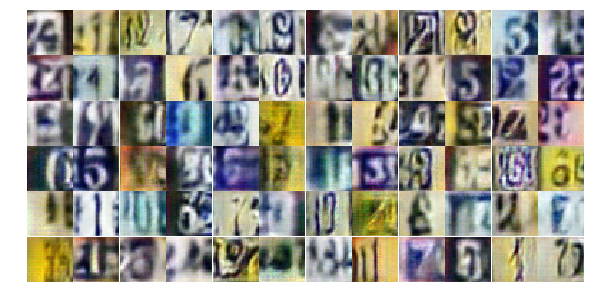

Epoch 13/25... Discriminator Loss: 1.0217... Generator Loss: 0.9164
Epoch 13/25... Discriminator Loss: 1.2941... Generator Loss: 0.5481
Epoch 13/25... Discriminator Loss: 1.0257... Generator Loss: 0.8244
Epoch 13/25... Discriminator Loss: 1.1677... Generator Loss: 0.7770
Epoch 14/25... Discriminator Loss: 1.2588... Generator Loss: 0.9400
Epoch 14/25... Discriminator Loss: 0.9919... Generator Loss: 0.9714
Epoch 14/25... Discriminator Loss: 1.0983... Generator Loss: 0.9257
Epoch 14/25... Discriminator Loss: 0.8722... Generator Loss: 1.4456
Epoch 14/25... Discriminator Loss: 0.9922... Generator Loss: 0.8628
Epoch 14/25... Discriminator Loss: 1.1352... Generator Loss: 0.6855


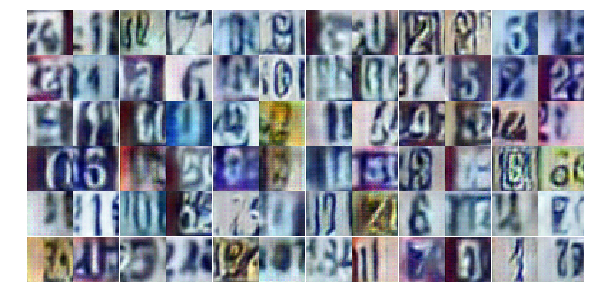

Epoch 14/25... Discriminator Loss: 1.1211... Generator Loss: 1.3713
Epoch 14/25... Discriminator Loss: 1.1184... Generator Loss: 0.5853
Epoch 14/25... Discriminator Loss: 0.9032... Generator Loss: 0.9645
Epoch 14/25... Discriminator Loss: 1.0462... Generator Loss: 0.8535
Epoch 14/25... Discriminator Loss: 1.6530... Generator Loss: 0.2916
Epoch 14/25... Discriminator Loss: 0.9253... Generator Loss: 0.8222
Epoch 14/25... Discriminator Loss: 0.9335... Generator Loss: 1.0517
Epoch 14/25... Discriminator Loss: 1.6591... Generator Loss: 0.3069
Epoch 14/25... Discriminator Loss: 1.1086... Generator Loss: 1.0228
Epoch 14/25... Discriminator Loss: 1.6558... Generator Loss: 0.2992


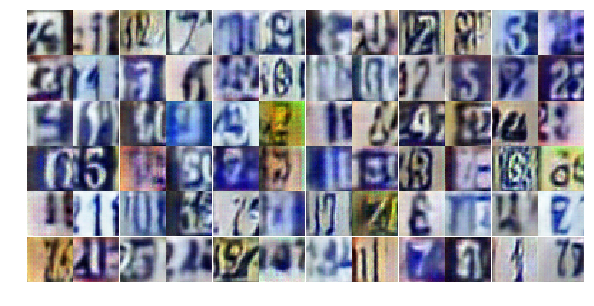

Epoch 14/25... Discriminator Loss: 1.0251... Generator Loss: 0.7193
Epoch 14/25... Discriminator Loss: 0.9802... Generator Loss: 1.0139
Epoch 14/25... Discriminator Loss: 1.1066... Generator Loss: 0.7917
Epoch 14/25... Discriminator Loss: 0.9176... Generator Loss: 0.8986
Epoch 14/25... Discriminator Loss: 1.2935... Generator Loss: 0.6059
Epoch 14/25... Discriminator Loss: 1.1178... Generator Loss: 0.7028
Epoch 14/25... Discriminator Loss: 1.4933... Generator Loss: 0.3856
Epoch 14/25... Discriminator Loss: 1.2257... Generator Loss: 0.5379
Epoch 14/25... Discriminator Loss: 1.1862... Generator Loss: 0.5997
Epoch 14/25... Discriminator Loss: 0.8032... Generator Loss: 1.6525


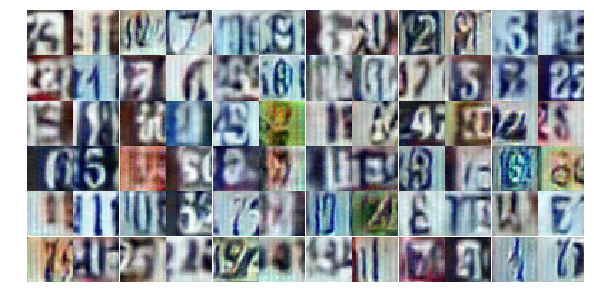

Epoch 14/25... Discriminator Loss: 1.5423... Generator Loss: 0.3404
Epoch 14/25... Discriminator Loss: 0.9095... Generator Loss: 1.1365
Epoch 14/25... Discriminator Loss: 0.7164... Generator Loss: 1.3572
Epoch 14/25... Discriminator Loss: 0.8430... Generator Loss: 1.2501
Epoch 14/25... Discriminator Loss: 1.0390... Generator Loss: 0.6641
Epoch 14/25... Discriminator Loss: 1.7172... Generator Loss: 0.2827
Epoch 14/25... Discriminator Loss: 0.5773... Generator Loss: 1.8430
Epoch 14/25... Discriminator Loss: 2.1666... Generator Loss: 0.1937
Epoch 14/25... Discriminator Loss: 0.2728... Generator Loss: 2.6287
Epoch 14/25... Discriminator Loss: 0.1385... Generator Loss: 2.3803


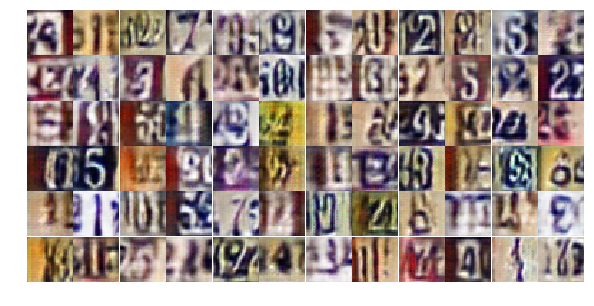

Epoch 14/25... Discriminator Loss: 1.7804... Generator Loss: 0.6340
Epoch 14/25... Discriminator Loss: 1.3009... Generator Loss: 2.0779
Epoch 14/25... Discriminator Loss: 0.9794... Generator Loss: 0.9384
Epoch 14/25... Discriminator Loss: 1.1659... Generator Loss: 0.6689
Epoch 14/25... Discriminator Loss: 1.3992... Generator Loss: 0.4618
Epoch 14/25... Discriminator Loss: 0.7953... Generator Loss: 1.3341
Epoch 14/25... Discriminator Loss: 0.4622... Generator Loss: 1.4765
Epoch 14/25... Discriminator Loss: 1.0728... Generator Loss: 0.5660
Epoch 14/25... Discriminator Loss: 1.4029... Generator Loss: 0.4218
Epoch 14/25... Discriminator Loss: 1.1468... Generator Loss: 0.8062


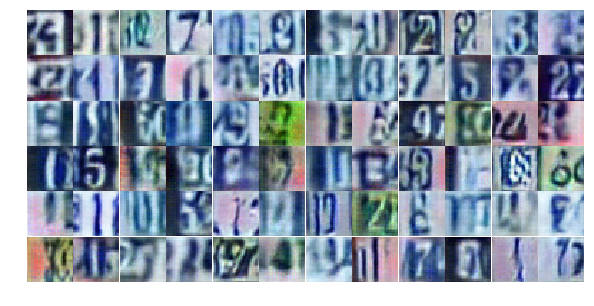

Epoch 14/25... Discriminator Loss: 1.2378... Generator Loss: 0.7831
Epoch 14/25... Discriminator Loss: 1.2005... Generator Loss: 0.5636
Epoch 14/25... Discriminator Loss: 1.2470... Generator Loss: 0.9119
Epoch 14/25... Discriminator Loss: 1.1493... Generator Loss: 0.6700
Epoch 14/25... Discriminator Loss: 1.3701... Generator Loss: 0.4710
Epoch 14/25... Discriminator Loss: 1.2829... Generator Loss: 0.5561
Epoch 14/25... Discriminator Loss: 1.0680... Generator Loss: 0.7318
Epoch 14/25... Discriminator Loss: 1.0425... Generator Loss: 0.8783
Epoch 14/25... Discriminator Loss: 1.2139... Generator Loss: 0.6258
Epoch 14/25... Discriminator Loss: 1.0569... Generator Loss: 0.7427


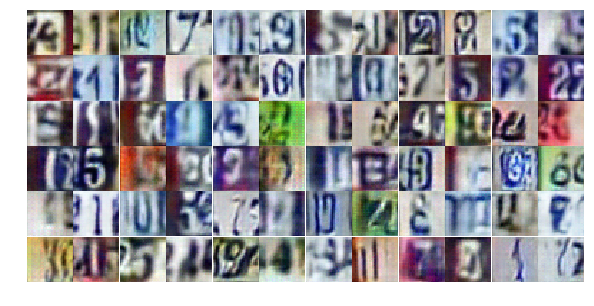

Epoch 14/25... Discriminator Loss: 1.6606... Generator Loss: 0.7510
Epoch 14/25... Discriminator Loss: 1.1641... Generator Loss: 0.6635
Epoch 15/25... Discriminator Loss: 0.6072... Generator Loss: 1.2542
Epoch 15/25... Discriminator Loss: 0.5422... Generator Loss: 1.5319
Epoch 15/25... Discriminator Loss: 1.5225... Generator Loss: 0.3361
Epoch 15/25... Discriminator Loss: 1.2750... Generator Loss: 0.5419
Epoch 15/25... Discriminator Loss: 1.1664... Generator Loss: 0.5867
Epoch 15/25... Discriminator Loss: 0.8275... Generator Loss: 1.2344
Epoch 15/25... Discriminator Loss: 1.1871... Generator Loss: 0.8992
Epoch 15/25... Discriminator Loss: 0.9318... Generator Loss: 0.8990


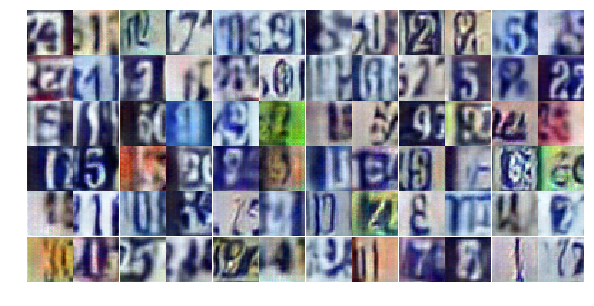

Epoch 15/25... Discriminator Loss: 0.9809... Generator Loss: 1.0357
Epoch 15/25... Discriminator Loss: 0.9922... Generator Loss: 1.0869
Epoch 15/25... Discriminator Loss: 1.1541... Generator Loss: 0.8310
Epoch 15/25... Discriminator Loss: 1.2993... Generator Loss: 0.5371
Epoch 15/25... Discriminator Loss: 1.2550... Generator Loss: 0.5716
Epoch 15/25... Discriminator Loss: 0.7370... Generator Loss: 1.2606
Epoch 15/25... Discriminator Loss: 1.5404... Generator Loss: 0.3963
Epoch 15/25... Discriminator Loss: 1.1875... Generator Loss: 0.5711
Epoch 15/25... Discriminator Loss: 1.3233... Generator Loss: 1.6288
Epoch 15/25... Discriminator Loss: 1.2794... Generator Loss: 0.5382


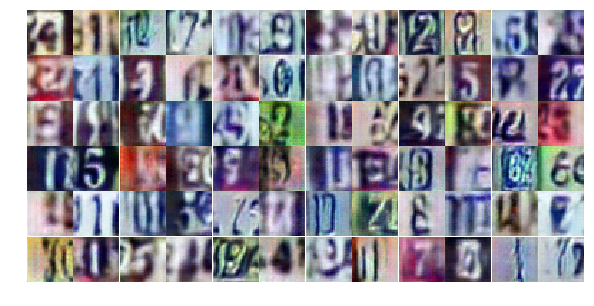

Epoch 15/25... Discriminator Loss: 0.6528... Generator Loss: 1.4812
Epoch 15/25... Discriminator Loss: 1.4443... Generator Loss: 0.4022
Epoch 15/25... Discriminator Loss: 1.1646... Generator Loss: 0.5359
Epoch 15/25... Discriminator Loss: 2.4041... Generator Loss: 0.4818
Epoch 15/25... Discriminator Loss: 1.0597... Generator Loss: 0.9066
Epoch 15/25... Discriminator Loss: 0.2530... Generator Loss: 2.4382
Epoch 15/25... Discriminator Loss: 2.7481... Generator Loss: 0.1041
Epoch 15/25... Discriminator Loss: 0.4531... Generator Loss: 1.5913
Epoch 15/25... Discriminator Loss: 1.4053... Generator Loss: 0.3942
Epoch 15/25... Discriminator Loss: 1.5046... Generator Loss: 0.4015


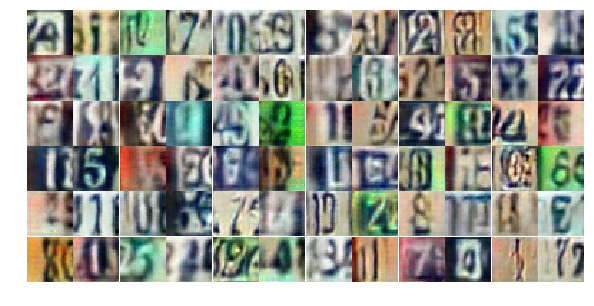

Epoch 15/25... Discriminator Loss: 1.2386... Generator Loss: 0.5760
Epoch 15/25... Discriminator Loss: 0.8836... Generator Loss: 1.5721
Epoch 15/25... Discriminator Loss: 0.7400... Generator Loss: 1.1705
Epoch 15/25... Discriminator Loss: 0.7804... Generator Loss: 1.4951
Epoch 15/25... Discriminator Loss: 0.6012... Generator Loss: 1.4043
Epoch 15/25... Discriminator Loss: 0.1646... Generator Loss: 2.3981
Epoch 15/25... Discriminator Loss: 0.0952... Generator Loss: 3.1007
Epoch 15/25... Discriminator Loss: 0.5952... Generator Loss: 6.1648
Epoch 15/25... Discriminator Loss: 0.7107... Generator Loss: 1.2283
Epoch 15/25... Discriminator Loss: 1.5622... Generator Loss: 0.3256


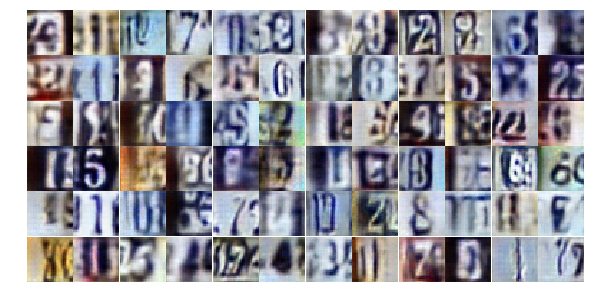

Epoch 15/25... Discriminator Loss: 0.5416... Generator Loss: 1.6242
Epoch 15/25... Discriminator Loss: 1.7967... Generator Loss: 0.2921
Epoch 15/25... Discriminator Loss: 1.3438... Generator Loss: 0.5329
Epoch 15/25... Discriminator Loss: 0.8714... Generator Loss: 1.2613
Epoch 15/25... Discriminator Loss: 0.9770... Generator Loss: 0.7091
Epoch 15/25... Discriminator Loss: 1.8160... Generator Loss: 0.2709
Epoch 15/25... Discriminator Loss: 0.8584... Generator Loss: 0.9215
Epoch 15/25... Discriminator Loss: 1.0748... Generator Loss: 1.3533
Epoch 15/25... Discriminator Loss: 0.8939... Generator Loss: 0.8678
Epoch 15/25... Discriminator Loss: 1.6869... Generator Loss: 0.2861


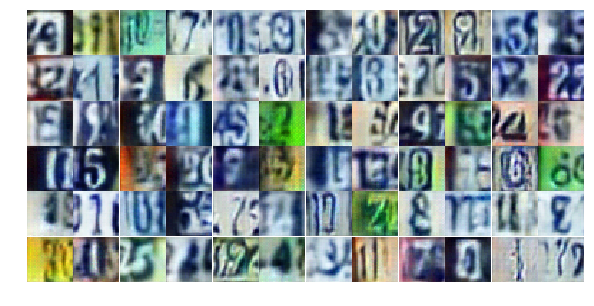

Epoch 15/25... Discriminator Loss: 1.1186... Generator Loss: 0.7304
Epoch 15/25... Discriminator Loss: 1.3894... Generator Loss: 0.4893
Epoch 15/25... Discriminator Loss: 0.8948... Generator Loss: 0.8590
Epoch 15/25... Discriminator Loss: 1.0246... Generator Loss: 0.7764
Epoch 15/25... Discriminator Loss: 0.3762... Generator Loss: 2.3089
Epoch 15/25... Discriminator Loss: 0.3821... Generator Loss: 1.5309
Epoch 15/25... Discriminator Loss: 0.0720... Generator Loss: 3.4417
Epoch 15/25... Discriminator Loss: 0.3841... Generator Loss: 3.9296
Epoch 15/25... Discriminator Loss: 1.3041... Generator Loss: 1.1368
Epoch 16/25... Discriminator Loss: 1.3225... Generator Loss: 0.7094


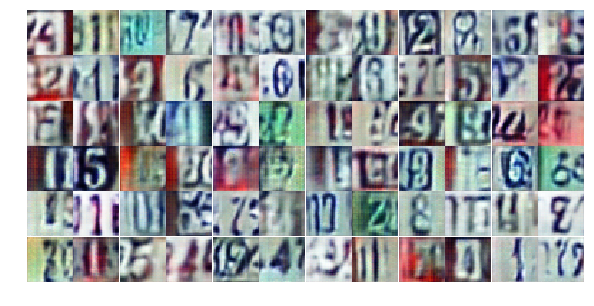

Epoch 16/25... Discriminator Loss: 1.0766... Generator Loss: 1.2144
Epoch 16/25... Discriminator Loss: 0.9019... Generator Loss: 1.2509
Epoch 16/25... Discriminator Loss: 1.2635... Generator Loss: 0.6864
Epoch 16/25... Discriminator Loss: 1.0391... Generator Loss: 1.1211
Epoch 16/25... Discriminator Loss: 1.0697... Generator Loss: 1.1543
Epoch 16/25... Discriminator Loss: 1.1930... Generator Loss: 0.7878
Epoch 16/25... Discriminator Loss: 1.3273... Generator Loss: 0.5480
Epoch 16/25... Discriminator Loss: 1.0719... Generator Loss: 0.7055
Epoch 16/25... Discriminator Loss: 1.1204... Generator Loss: 0.6794
Epoch 16/25... Discriminator Loss: 0.8712... Generator Loss: 0.9815


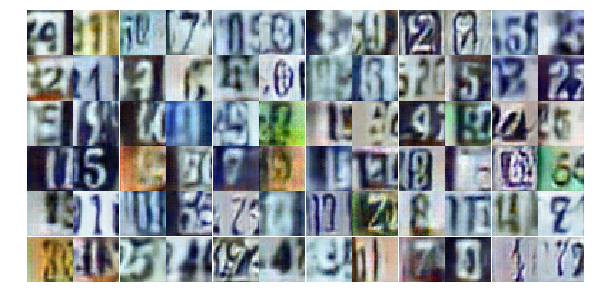

Epoch 16/25... Discriminator Loss: 1.1871... Generator Loss: 0.6177
Epoch 16/25... Discriminator Loss: 1.1025... Generator Loss: 0.9603
Epoch 16/25... Discriminator Loss: 1.2395... Generator Loss: 0.7436
Epoch 16/25... Discriminator Loss: 1.1893... Generator Loss: 0.6372
Epoch 16/25... Discriminator Loss: 1.0625... Generator Loss: 0.9515
Epoch 16/25... Discriminator Loss: 1.1945... Generator Loss: 0.5489
Epoch 16/25... Discriminator Loss: 1.2477... Generator Loss: 0.6096
Epoch 16/25... Discriminator Loss: 1.0013... Generator Loss: 0.9869
Epoch 16/25... Discriminator Loss: 0.8801... Generator Loss: 0.9074
Epoch 16/25... Discriminator Loss: 0.9827... Generator Loss: 0.8563


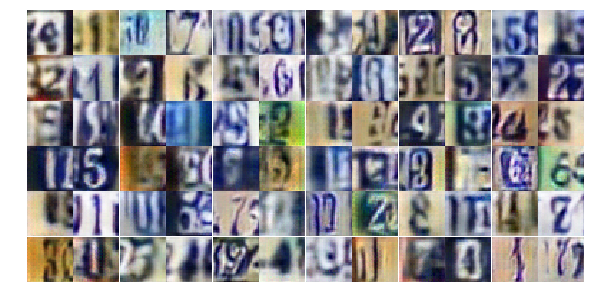

Epoch 16/25... Discriminator Loss: 1.1468... Generator Loss: 0.9080
Epoch 16/25... Discriminator Loss: 0.9953... Generator Loss: 0.9609
Epoch 16/25... Discriminator Loss: 1.0645... Generator Loss: 0.7928
Epoch 16/25... Discriminator Loss: 1.2488... Generator Loss: 0.5666
Epoch 16/25... Discriminator Loss: 0.9287... Generator Loss: 1.0207
Epoch 16/25... Discriminator Loss: 0.8722... Generator Loss: 1.0393
Epoch 16/25... Discriminator Loss: 1.1799... Generator Loss: 0.6234
Epoch 16/25... Discriminator Loss: 1.0790... Generator Loss: 0.7207
Epoch 16/25... Discriminator Loss: 1.0417... Generator Loss: 0.8986
Epoch 16/25... Discriminator Loss: 1.0448... Generator Loss: 1.1232


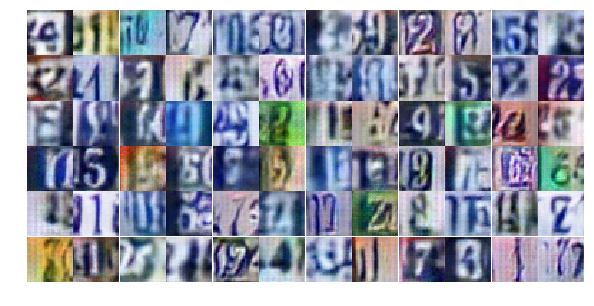

Epoch 16/25... Discriminator Loss: 0.9408... Generator Loss: 0.9125
Epoch 16/25... Discriminator Loss: 0.9235... Generator Loss: 1.2642
Epoch 16/25... Discriminator Loss: 1.0575... Generator Loss: 0.9112
Epoch 16/25... Discriminator Loss: 0.9950... Generator Loss: 0.7779
Epoch 16/25... Discriminator Loss: 1.4085... Generator Loss: 0.6645
Epoch 16/25... Discriminator Loss: 1.1153... Generator Loss: 1.1206
Epoch 16/25... Discriminator Loss: 1.3600... Generator Loss: 0.4713
Epoch 16/25... Discriminator Loss: 1.3613... Generator Loss: 0.4802
Epoch 16/25... Discriminator Loss: 1.2202... Generator Loss: 0.5159
Epoch 16/25... Discriminator Loss: 0.8665... Generator Loss: 1.2450


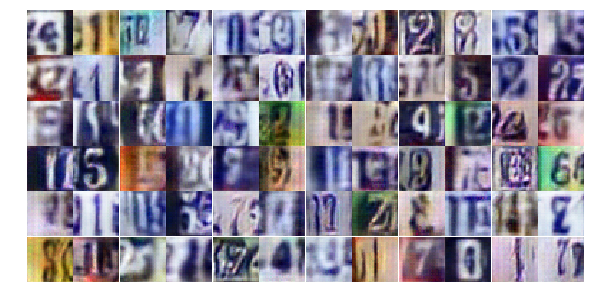

Epoch 16/25... Discriminator Loss: 0.8477... Generator Loss: 1.0987
Epoch 16/25... Discriminator Loss: 0.9870... Generator Loss: 0.8480
Epoch 16/25... Discriminator Loss: 1.4315... Generator Loss: 0.4212
Epoch 16/25... Discriminator Loss: 1.3494... Generator Loss: 0.5651
Epoch 16/25... Discriminator Loss: 0.8712... Generator Loss: 1.1790
Epoch 16/25... Discriminator Loss: 1.1830... Generator Loss: 0.7301
Epoch 16/25... Discriminator Loss: 0.9897... Generator Loss: 1.3369
Epoch 16/25... Discriminator Loss: 1.2132... Generator Loss: 0.7496
Epoch 16/25... Discriminator Loss: 0.8744... Generator Loss: 0.9029
Epoch 16/25... Discriminator Loss: 1.0732... Generator Loss: 0.8149


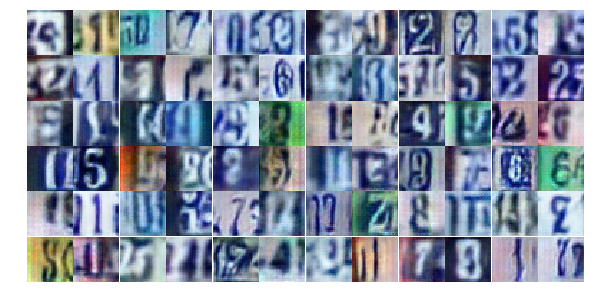

Epoch 16/25... Discriminator Loss: 1.2506... Generator Loss: 0.6318
Epoch 16/25... Discriminator Loss: 0.8895... Generator Loss: 1.1823
Epoch 16/25... Discriminator Loss: 1.0578... Generator Loss: 0.9757
Epoch 16/25... Discriminator Loss: 0.7160... Generator Loss: 1.1386
Epoch 16/25... Discriminator Loss: 1.2495... Generator Loss: 0.5500
Epoch 16/25... Discriminator Loss: 1.2473... Generator Loss: 0.7031
Epoch 17/25... Discriminator Loss: 0.9508... Generator Loss: 0.9422
Epoch 17/25... Discriminator Loss: 1.2864... Generator Loss: 0.5660
Epoch 17/25... Discriminator Loss: 1.2969... Generator Loss: 0.6802
Epoch 17/25... Discriminator Loss: 1.1377... Generator Loss: 0.5888


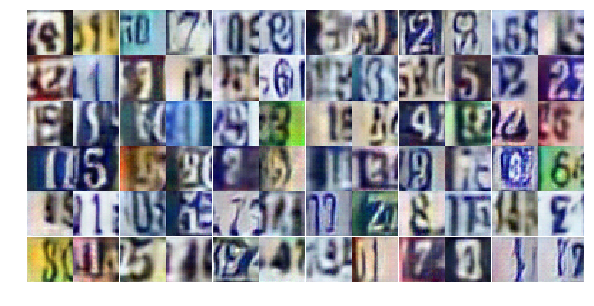

Epoch 17/25... Discriminator Loss: 0.7459... Generator Loss: 1.1390
Epoch 17/25... Discriminator Loss: 0.9509... Generator Loss: 0.8550
Epoch 17/25... Discriminator Loss: 1.4356... Generator Loss: 0.5053
Epoch 17/25... Discriminator Loss: 1.0076... Generator Loss: 1.0437
Epoch 17/25... Discriminator Loss: 1.2471... Generator Loss: 0.5680
Epoch 17/25... Discriminator Loss: 1.3542... Generator Loss: 0.5023
Epoch 17/25... Discriminator Loss: 1.1253... Generator Loss: 0.9657
Epoch 17/25... Discriminator Loss: 0.8475... Generator Loss: 0.9207
Epoch 17/25... Discriminator Loss: 0.9321... Generator Loss: 0.8426
Epoch 17/25... Discriminator Loss: 0.9833... Generator Loss: 2.2515


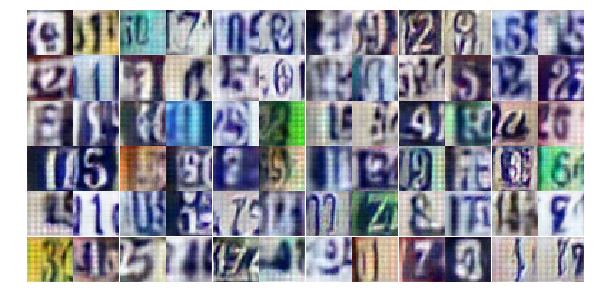

Epoch 17/25... Discriminator Loss: 1.0020... Generator Loss: 0.9758
Epoch 17/25... Discriminator Loss: 1.0470... Generator Loss: 1.4046
Epoch 17/25... Discriminator Loss: 1.0103... Generator Loss: 0.7525
Epoch 17/25... Discriminator Loss: 1.3965... Generator Loss: 0.4860
Epoch 17/25... Discriminator Loss: 1.0527... Generator Loss: 0.9199
Epoch 17/25... Discriminator Loss: 0.9993... Generator Loss: 0.7057
Epoch 17/25... Discriminator Loss: 0.7914... Generator Loss: 1.1055
Epoch 17/25... Discriminator Loss: 1.0322... Generator Loss: 0.8455
Epoch 17/25... Discriminator Loss: 0.9279... Generator Loss: 0.9334
Epoch 17/25... Discriminator Loss: 1.0245... Generator Loss: 0.7968


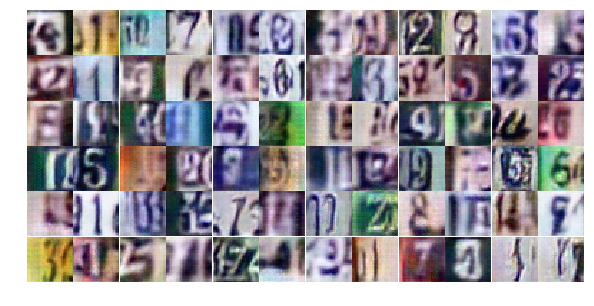

Epoch 17/25... Discriminator Loss: 1.1562... Generator Loss: 1.3690
Epoch 17/25... Discriminator Loss: 0.6907... Generator Loss: 1.2585
Epoch 17/25... Discriminator Loss: 0.8414... Generator Loss: 1.2140
Epoch 17/25... Discriminator Loss: 1.5581... Generator Loss: 0.4204
Epoch 17/25... Discriminator Loss: 1.6962... Generator Loss: 0.3364
Epoch 17/25... Discriminator Loss: 0.9058... Generator Loss: 0.8034
Epoch 17/25... Discriminator Loss: 1.0324... Generator Loss: 0.6978
Epoch 17/25... Discriminator Loss: 0.8894... Generator Loss: 0.8682
Epoch 17/25... Discriminator Loss: 2.0575... Generator Loss: 0.2497
Epoch 17/25... Discriminator Loss: 0.7233... Generator Loss: 1.2227


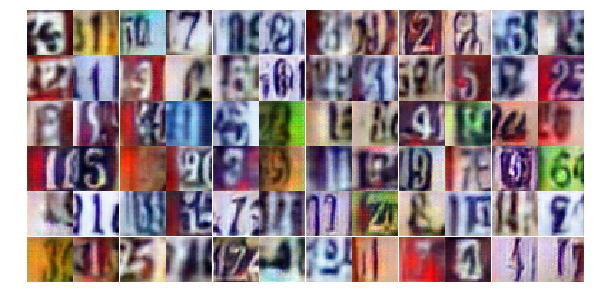

Epoch 17/25... Discriminator Loss: 0.1071... Generator Loss: 3.0500
Epoch 17/25... Discriminator Loss: 2.4587... Generator Loss: 0.1770
Epoch 17/25... Discriminator Loss: 0.5004... Generator Loss: 1.4038
Epoch 17/25... Discriminator Loss: 1.1891... Generator Loss: 0.7390
Epoch 17/25... Discriminator Loss: 1.3975... Generator Loss: 0.7907
Epoch 17/25... Discriminator Loss: 1.0997... Generator Loss: 0.6923
Epoch 17/25... Discriminator Loss: 1.2958... Generator Loss: 0.5718
Epoch 17/25... Discriminator Loss: 0.9152... Generator Loss: 0.9702
Epoch 17/25... Discriminator Loss: 0.9175... Generator Loss: 0.8844
Epoch 17/25... Discriminator Loss: 1.6723... Generator Loss: 0.3632


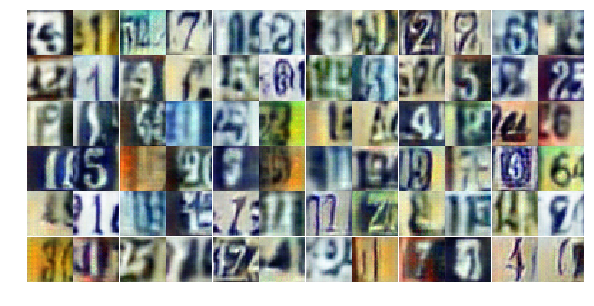

Epoch 17/25... Discriminator Loss: 0.6812... Generator Loss: 1.0542
Epoch 17/25... Discriminator Loss: 0.0936... Generator Loss: 2.9175
Epoch 17/25... Discriminator Loss: 2.7096... Generator Loss: 0.1519
Epoch 17/25... Discriminator Loss: 0.6117... Generator Loss: 2.0495
Epoch 17/25... Discriminator Loss: 1.2601... Generator Loss: 0.8925
Epoch 17/25... Discriminator Loss: 1.1267... Generator Loss: 0.7026
Epoch 17/25... Discriminator Loss: 1.6629... Generator Loss: 0.3559
Epoch 17/25... Discriminator Loss: 1.9150... Generator Loss: 0.3255
Epoch 17/25... Discriminator Loss: 0.6966... Generator Loss: 1.1063
Epoch 17/25... Discriminator Loss: 1.2155... Generator Loss: 2.3192


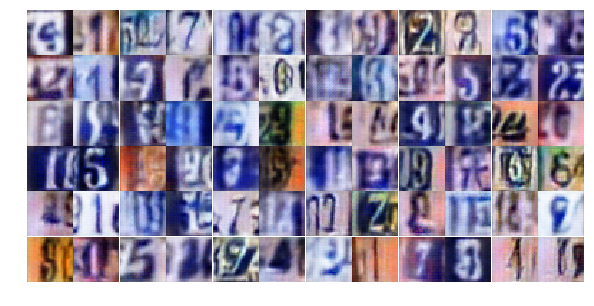

Epoch 17/25... Discriminator Loss: 1.2766... Generator Loss: 0.6653
Epoch 17/25... Discriminator Loss: 0.9564... Generator Loss: 0.9035
Epoch 17/25... Discriminator Loss: 1.0961... Generator Loss: 0.6988
Epoch 17/25... Discriminator Loss: 0.8037... Generator Loss: 1.3109
Epoch 18/25... Discriminator Loss: 2.0573... Generator Loss: 0.2887
Epoch 18/25... Discriminator Loss: 1.4132... Generator Loss: 0.4266
Epoch 18/25... Discriminator Loss: 0.9791... Generator Loss: 0.9444
Epoch 18/25... Discriminator Loss: 0.9318... Generator Loss: 0.9135
Epoch 18/25... Discriminator Loss: 1.2719... Generator Loss: 0.6755
Epoch 18/25... Discriminator Loss: 0.9726... Generator Loss: 1.1431


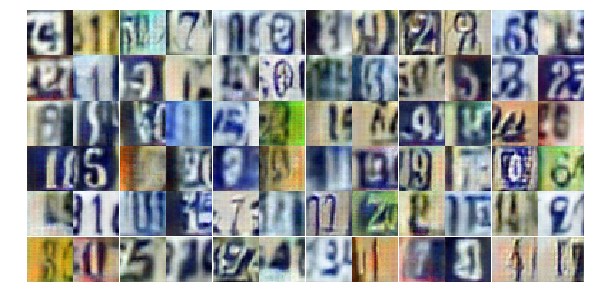

Epoch 18/25... Discriminator Loss: 0.8099... Generator Loss: 1.0765
Epoch 18/25... Discriminator Loss: 1.2263... Generator Loss: 0.5330
Epoch 18/25... Discriminator Loss: 1.1666... Generator Loss: 0.5786
Epoch 18/25... Discriminator Loss: 0.6568... Generator Loss: 1.6427
Epoch 18/25... Discriminator Loss: 0.1549... Generator Loss: 2.2625
Epoch 18/25... Discriminator Loss: 0.0906... Generator Loss: 3.3069
Epoch 18/25... Discriminator Loss: 0.3128... Generator Loss: 2.0686
Epoch 18/25... Discriminator Loss: 0.8217... Generator Loss: 0.9057
Epoch 18/25... Discriminator Loss: 0.8143... Generator Loss: 2.5221
Epoch 18/25... Discriminator Loss: 0.7884... Generator Loss: 1.1178


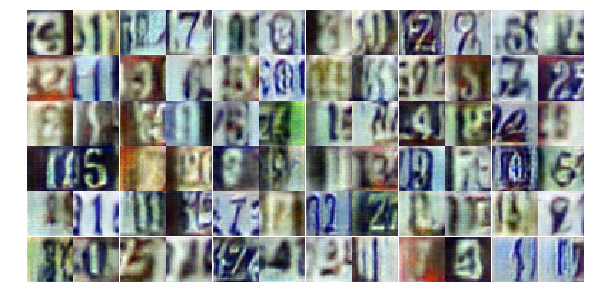

Epoch 18/25... Discriminator Loss: 0.8252... Generator Loss: 1.1376
Epoch 18/25... Discriminator Loss: 0.9083... Generator Loss: 1.0572
Epoch 18/25... Discriminator Loss: 1.2650... Generator Loss: 0.6843
Epoch 18/25... Discriminator Loss: 0.7304... Generator Loss: 1.1873
Epoch 18/25... Discriminator Loss: 1.2489... Generator Loss: 0.5115
Epoch 18/25... Discriminator Loss: 0.8830... Generator Loss: 0.9431
Epoch 18/25... Discriminator Loss: 1.0538... Generator Loss: 1.0284
Epoch 18/25... Discriminator Loss: 1.0438... Generator Loss: 0.7631
Epoch 18/25... Discriminator Loss: 0.9723... Generator Loss: 0.9492
Epoch 18/25... Discriminator Loss: 0.9282... Generator Loss: 0.9394


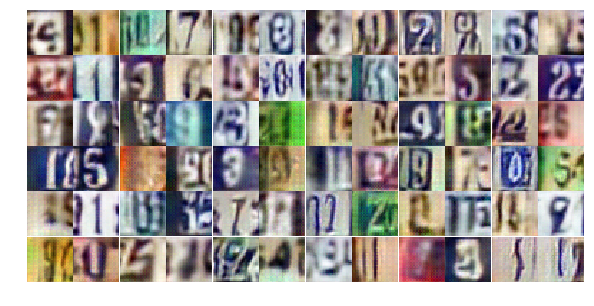

Epoch 18/25... Discriminator Loss: 0.7669... Generator Loss: 1.0362
Epoch 18/25... Discriminator Loss: 1.2269... Generator Loss: 0.7125
Epoch 18/25... Discriminator Loss: 1.0740... Generator Loss: 0.6874
Epoch 18/25... Discriminator Loss: 1.0732... Generator Loss: 0.9632
Epoch 18/25... Discriminator Loss: 1.3174... Generator Loss: 0.5330
Epoch 18/25... Discriminator Loss: 0.6708... Generator Loss: 1.3359
Epoch 18/25... Discriminator Loss: 1.0950... Generator Loss: 0.8458
Epoch 18/25... Discriminator Loss: 1.5062... Generator Loss: 0.4164
Epoch 18/25... Discriminator Loss: 0.9948... Generator Loss: 0.7705
Epoch 18/25... Discriminator Loss: 1.2497... Generator Loss: 0.6041


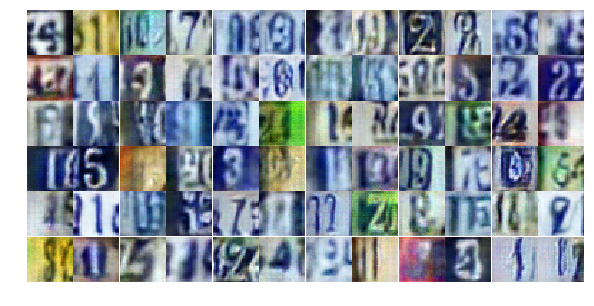

Epoch 18/25... Discriminator Loss: 1.1486... Generator Loss: 0.9515
Epoch 18/25... Discriminator Loss: 0.8013... Generator Loss: 0.9021
Epoch 18/25... Discriminator Loss: 0.9887... Generator Loss: 0.7674
Epoch 18/25... Discriminator Loss: 0.6843... Generator Loss: 1.2929
Epoch 18/25... Discriminator Loss: 1.1040... Generator Loss: 0.9305
Epoch 18/25... Discriminator Loss: 0.9343... Generator Loss: 0.7656
Epoch 18/25... Discriminator Loss: 1.2077... Generator Loss: 0.5613
Epoch 18/25... Discriminator Loss: 1.1313... Generator Loss: 0.7907
Epoch 18/25... Discriminator Loss: 0.7400... Generator Loss: 1.0710
Epoch 18/25... Discriminator Loss: 0.5705... Generator Loss: 1.8051


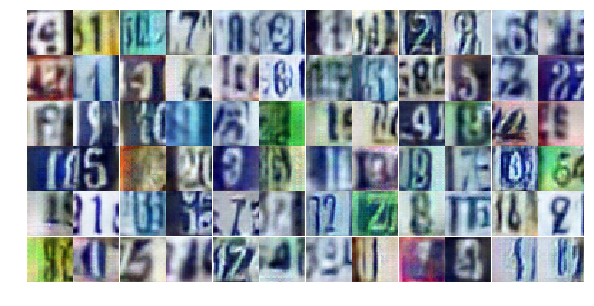

Epoch 18/25... Discriminator Loss: 0.7576... Generator Loss: 1.1741
Epoch 18/25... Discriminator Loss: 1.4860... Generator Loss: 0.4053
Epoch 18/25... Discriminator Loss: 0.9377... Generator Loss: 0.9639
Epoch 18/25... Discriminator Loss: 1.8979... Generator Loss: 0.3058
Epoch 18/25... Discriminator Loss: 0.8479... Generator Loss: 0.9754
Epoch 18/25... Discriminator Loss: 1.3837... Generator Loss: 1.8031
Epoch 18/25... Discriminator Loss: 0.0746... Generator Loss: 3.6416
Epoch 18/25... Discriminator Loss: 0.7283... Generator Loss: 1.8964
Epoch 18/25... Discriminator Loss: 1.0624... Generator Loss: 1.1432
Epoch 18/25... Discriminator Loss: 0.6429... Generator Loss: 1.1503


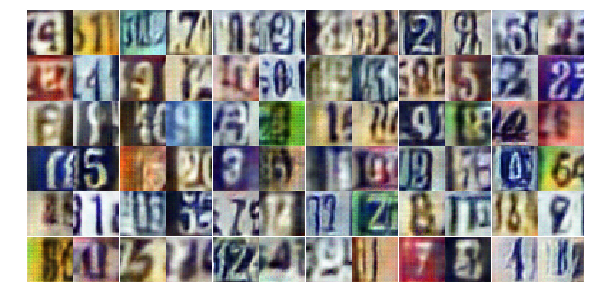

Epoch 18/25... Discriminator Loss: 1.1322... Generator Loss: 2.0929
Epoch 19/25... Discriminator Loss: 0.9772... Generator Loss: 0.7454
Epoch 19/25... Discriminator Loss: 1.2910... Generator Loss: 0.5781
Epoch 19/25... Discriminator Loss: 0.1922... Generator Loss: 3.3356
Epoch 19/25... Discriminator Loss: 0.0468... Generator Loss: 4.0197
Epoch 19/25... Discriminator Loss: 0.0398... Generator Loss: 4.0194
Epoch 19/25... Discriminator Loss: 0.0483... Generator Loss: 3.7043
Epoch 19/25... Discriminator Loss: 0.0370... Generator Loss: 4.0308
Epoch 19/25... Discriminator Loss: 0.0417... Generator Loss: 4.5751
Epoch 19/25... Discriminator Loss: 0.0947... Generator Loss: 3.0019


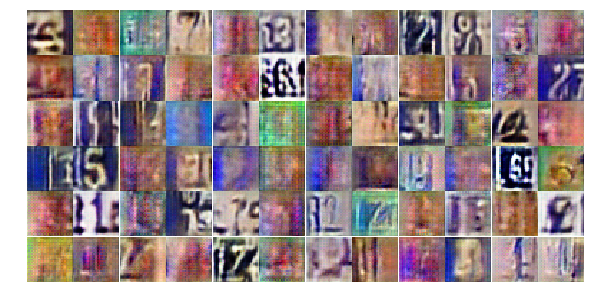

Epoch 19/25... Discriminator Loss: 0.0260... Generator Loss: 4.5148
Epoch 19/25... Discriminator Loss: 0.0474... Generator Loss: 3.6219
Epoch 19/25... Discriminator Loss: 0.0247... Generator Loss: 4.6717
Epoch 19/25... Discriminator Loss: 0.0283... Generator Loss: 4.1379
Epoch 19/25... Discriminator Loss: 0.0131... Generator Loss: 5.0506
Epoch 19/25... Discriminator Loss: 0.0233... Generator Loss: 4.0996
Epoch 19/25... Discriminator Loss: 0.0073... Generator Loss: 5.8780
Epoch 19/25... Discriminator Loss: 0.0125... Generator Loss: 5.7690
Epoch 19/25... Discriminator Loss: 0.0137... Generator Loss: 5.4058
Epoch 19/25... Discriminator Loss: 0.0099... Generator Loss: 4.8266


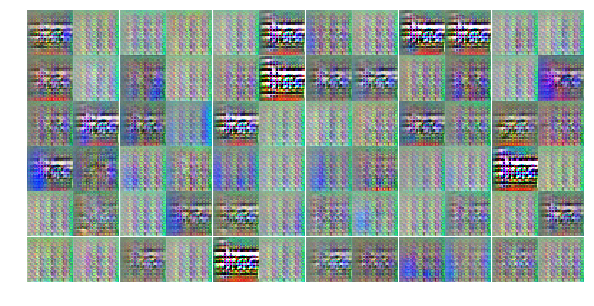

Epoch 19/25... Discriminator Loss: 0.0142... Generator Loss: 4.5110
Epoch 19/25... Discriminator Loss: 0.0029... Generator Loss: 6.5006
Epoch 19/25... Discriminator Loss: 0.0016... Generator Loss: 7.5349
Epoch 19/25... Discriminator Loss: 0.0089... Generator Loss: 7.4388
Epoch 19/25... Discriminator Loss: 0.1127... Generator Loss: 2.6257
Epoch 19/25... Discriminator Loss: 0.0028... Generator Loss: 7.2064
Epoch 19/25... Discriminator Loss: 0.0131... Generator Loss: 4.7076
Epoch 19/25... Discriminator Loss: 0.0041... Generator Loss: 14.3901
Epoch 19/25... Discriminator Loss: 0.0043... Generator Loss: 6.1371
Epoch 19/25... Discriminator Loss: 0.0034... Generator Loss: 10.7807


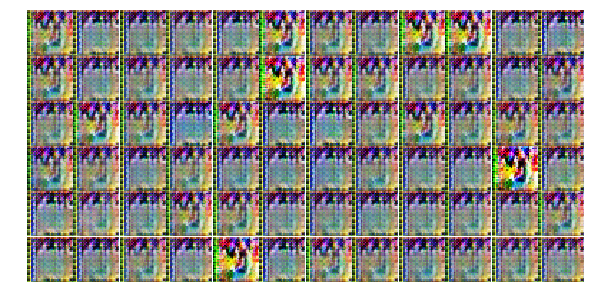

Epoch 19/25... Discriminator Loss: 0.0022... Generator Loss: 10.0354
Epoch 19/25... Discriminator Loss: 0.0023... Generator Loss: 10.1789
Epoch 19/25... Discriminator Loss: 0.0030... Generator Loss: 7.6767
Epoch 19/25... Discriminator Loss: 0.3537... Generator Loss: 6.8607
Epoch 19/25... Discriminator Loss: 0.2270... Generator Loss: 3.5982
Epoch 19/25... Discriminator Loss: 1.5997... Generator Loss: 4.1291
Epoch 19/25... Discriminator Loss: 0.4126... Generator Loss: 3.3663
Epoch 19/25... Discriminator Loss: 0.3816... Generator Loss: 3.1324
Epoch 19/25... Discriminator Loss: 1.8446... Generator Loss: 2.7228
Epoch 19/25... Discriminator Loss: 1.2993... Generator Loss: 2.3966


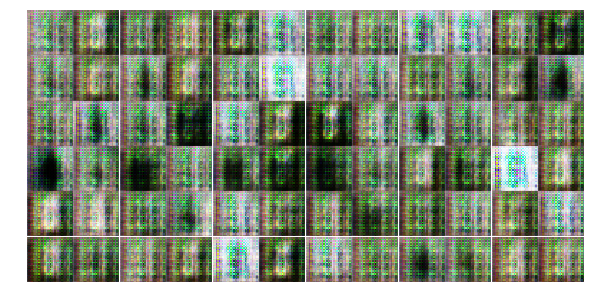

Epoch 19/25... Discriminator Loss: 1.1833... Generator Loss: 1.0021
Epoch 19/25... Discriminator Loss: 1.1304... Generator Loss: 1.0692
Epoch 19/25... Discriminator Loss: 1.8097... Generator Loss: 0.8100
Epoch 19/25... Discriminator Loss: 0.7523... Generator Loss: 1.2452
Epoch 19/25... Discriminator Loss: 1.7924... Generator Loss: 0.9758
Epoch 19/25... Discriminator Loss: 1.1923... Generator Loss: 3.0086
Epoch 19/25... Discriminator Loss: 0.7267... Generator Loss: 1.8403
Epoch 19/25... Discriminator Loss: 0.8998... Generator Loss: 1.7506
Epoch 19/25... Discriminator Loss: 0.7521... Generator Loss: 1.6975
Epoch 19/25... Discriminator Loss: 1.1451... Generator Loss: 2.6510


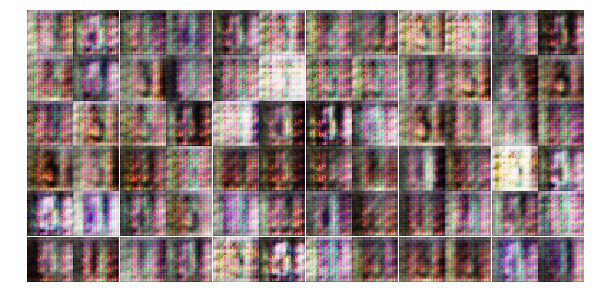

Epoch 19/25... Discriminator Loss: 0.9812... Generator Loss: 1.8651
Epoch 19/25... Discriminator Loss: 0.9582... Generator Loss: 1.6605
Epoch 19/25... Discriminator Loss: 0.8536... Generator Loss: 0.9922
Epoch 19/25... Discriminator Loss: 1.0599... Generator Loss: 1.0655
Epoch 19/25... Discriminator Loss: 0.5170... Generator Loss: 3.1328
Epoch 19/25... Discriminator Loss: 0.5019... Generator Loss: 4.7691
Epoch 19/25... Discriminator Loss: 0.6386... Generator Loss: 1.4467
Epoch 19/25... Discriminator Loss: 0.3783... Generator Loss: 3.7183
Epoch 20/25... Discriminator Loss: 0.2368... Generator Loss: 3.5706
Epoch 20/25... Discriminator Loss: 0.3859... Generator Loss: 2.6537


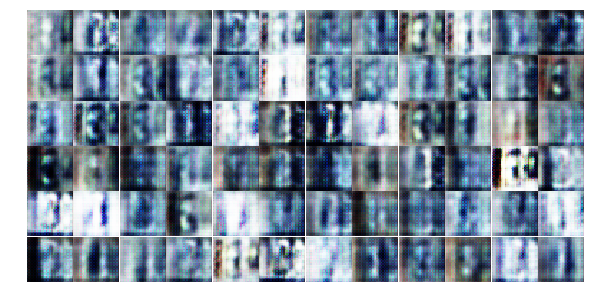

Epoch 20/25... Discriminator Loss: 0.3473... Generator Loss: 2.4406
Epoch 20/25... Discriminator Loss: 0.1652... Generator Loss: 3.3158
Epoch 20/25... Discriminator Loss: 0.6537... Generator Loss: 5.3651
Epoch 20/25... Discriminator Loss: 0.3466... Generator Loss: 2.2167
Epoch 20/25... Discriminator Loss: 0.1518... Generator Loss: 4.1397
Epoch 20/25... Discriminator Loss: 0.2924... Generator Loss: 2.3453
Epoch 20/25... Discriminator Loss: 0.2472... Generator Loss: 2.1247
Epoch 20/25... Discriminator Loss: 0.2236... Generator Loss: 2.9364
Epoch 20/25... Discriminator Loss: 0.1108... Generator Loss: 3.6194
Epoch 20/25... Discriminator Loss: 0.1301... Generator Loss: 3.6387


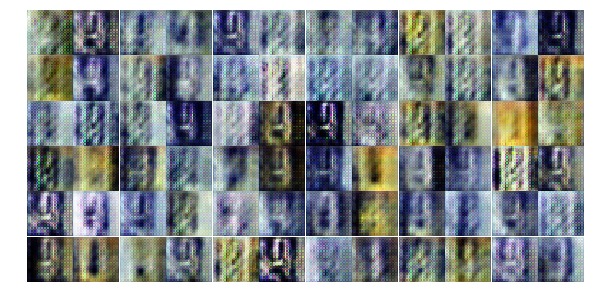

Epoch 20/25... Discriminator Loss: 0.4400... Generator Loss: 2.0314
Epoch 20/25... Discriminator Loss: 0.2721... Generator Loss: 2.5640
Epoch 20/25... Discriminator Loss: 0.2303... Generator Loss: 4.0582
Epoch 20/25... Discriminator Loss: 0.1636... Generator Loss: 2.9934
Epoch 20/25... Discriminator Loss: 0.1664... Generator Loss: 4.5495
Epoch 20/25... Discriminator Loss: 0.1388... Generator Loss: 3.3647
Epoch 20/25... Discriminator Loss: 0.1321... Generator Loss: 3.9828
Epoch 20/25... Discriminator Loss: 0.1365... Generator Loss: 3.1916
Epoch 20/25... Discriminator Loss: 0.2304... Generator Loss: 2.7049
Epoch 20/25... Discriminator Loss: 0.2960... Generator Loss: 1.9153


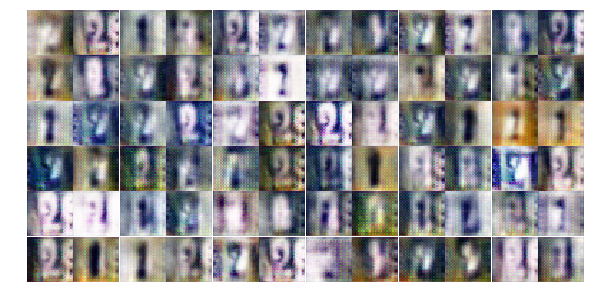

Epoch 20/25... Discriminator Loss: 0.1532... Generator Loss: 3.8789
Epoch 20/25... Discriminator Loss: 0.1989... Generator Loss: 3.2301
Epoch 20/25... Discriminator Loss: 0.1579... Generator Loss: 2.6952
Epoch 20/25... Discriminator Loss: 0.2223... Generator Loss: 2.5565
Epoch 20/25... Discriminator Loss: 0.1058... Generator Loss: 3.1359
Epoch 20/25... Discriminator Loss: 0.5027... Generator Loss: 10.9093
Epoch 20/25... Discriminator Loss: 0.2417... Generator Loss: 3.0869
Epoch 20/25... Discriminator Loss: 0.1949... Generator Loss: 2.6800
Epoch 20/25... Discriminator Loss: 0.2275... Generator Loss: 2.4516
Epoch 20/25... Discriminator Loss: 0.0941... Generator Loss: 3.4943


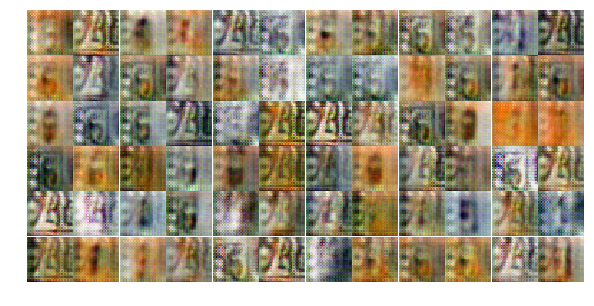

Epoch 20/25... Discriminator Loss: 0.0799... Generator Loss: 4.7364
Epoch 20/25... Discriminator Loss: 0.1241... Generator Loss: 3.2770
Epoch 20/25... Discriminator Loss: 1.4722... Generator Loss: 0.8230
Epoch 20/25... Discriminator Loss: 0.1415... Generator Loss: 3.2639
Epoch 20/25... Discriminator Loss: 0.2708... Generator Loss: 2.0464
Epoch 20/25... Discriminator Loss: 0.1039... Generator Loss: 4.0712
Epoch 20/25... Discriminator Loss: 0.3145... Generator Loss: 6.5675
Epoch 20/25... Discriminator Loss: 0.1618... Generator Loss: 3.4124
Epoch 20/25... Discriminator Loss: 0.1350... Generator Loss: 3.3012
Epoch 20/25... Discriminator Loss: 0.1232... Generator Loss: 3.1664


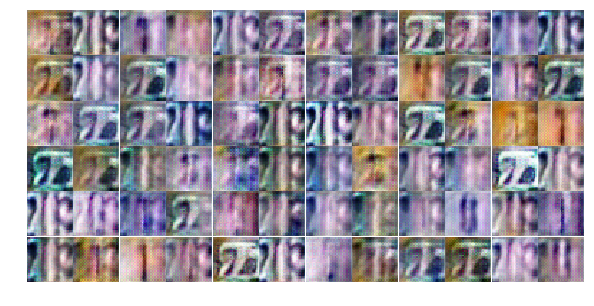

Epoch 20/25... Discriminator Loss: 0.1259... Generator Loss: 2.7452
Epoch 20/25... Discriminator Loss: 0.6937... Generator Loss: 6.7121
Epoch 20/25... Discriminator Loss: 0.3330... Generator Loss: 6.0637
Epoch 20/25... Discriminator Loss: 0.2080... Generator Loss: 3.8042
Epoch 20/25... Discriminator Loss: 0.3194... Generator Loss: 2.2843
Epoch 20/25... Discriminator Loss: 0.3448... Generator Loss: 2.3191
Epoch 20/25... Discriminator Loss: 0.1460... Generator Loss: 3.4383
Epoch 20/25... Discriminator Loss: 0.1367... Generator Loss: 4.1915
Epoch 20/25... Discriminator Loss: 0.1464... Generator Loss: 3.2403
Epoch 20/25... Discriminator Loss: 0.1537... Generator Loss: 2.8887


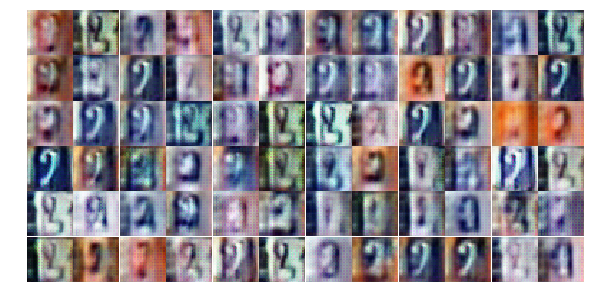

Epoch 20/25... Discriminator Loss: 0.1307... Generator Loss: 3.4994
Epoch 20/25... Discriminator Loss: 0.1184... Generator Loss: 3.2316
Epoch 20/25... Discriminator Loss: 0.1393... Generator Loss: 3.3210
Epoch 20/25... Discriminator Loss: 0.1040... Generator Loss: 3.6820
Epoch 20/25... Discriminator Loss: 0.1618... Generator Loss: 3.2466
Epoch 20/25... Discriminator Loss: 0.0612... Generator Loss: 4.0603
Epoch 21/25... Discriminator Loss: 0.1325... Generator Loss: 3.1191
Epoch 21/25... Discriminator Loss: 0.1320... Generator Loss: 3.4991
Epoch 21/25... Discriminator Loss: 0.0947... Generator Loss: 3.3311
Epoch 21/25... Discriminator Loss: 0.0279... Generator Loss: 5.8821


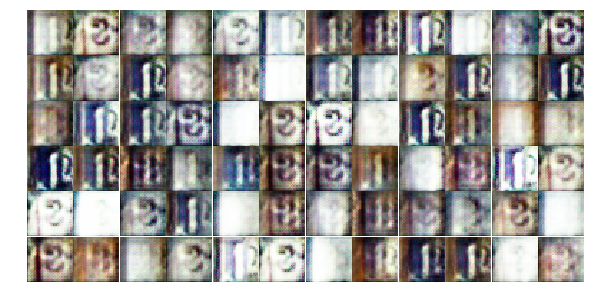

Epoch 21/25... Discriminator Loss: 0.0404... Generator Loss: 4.3261
Epoch 21/25... Discriminator Loss: 0.1562... Generator Loss: 5.7431
Epoch 21/25... Discriminator Loss: 0.0749... Generator Loss: 4.4007
Epoch 21/25... Discriminator Loss: 0.0815... Generator Loss: 3.9632
Epoch 21/25... Discriminator Loss: 0.1472... Generator Loss: 3.2367
Epoch 21/25... Discriminator Loss: 0.2041... Generator Loss: 3.6973
Epoch 21/25... Discriminator Loss: 0.1830... Generator Loss: 3.7375
Epoch 21/25... Discriminator Loss: 0.1422... Generator Loss: 4.9909
Epoch 21/25... Discriminator Loss: 0.2361... Generator Loss: 2.2096
Epoch 21/25... Discriminator Loss: 0.1399... Generator Loss: 3.8161


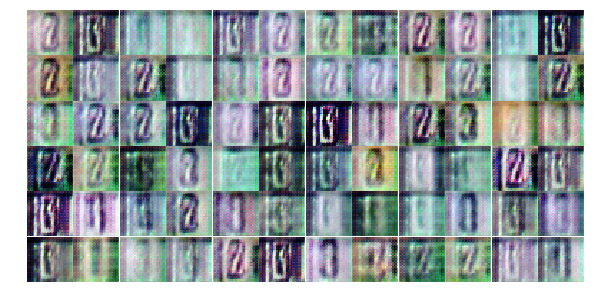

Epoch 21/25... Discriminator Loss: 0.0995... Generator Loss: 5.0841
Epoch 21/25... Discriminator Loss: 0.1427... Generator Loss: 3.3151
Epoch 21/25... Discriminator Loss: 0.0398... Generator Loss: 4.8329
Epoch 21/25... Discriminator Loss: 0.2994... Generator Loss: 2.1770
Epoch 21/25... Discriminator Loss: 0.1109... Generator Loss: 3.6135
Epoch 21/25... Discriminator Loss: 0.2755... Generator Loss: 2.3751
Epoch 21/25... Discriminator Loss: 0.2965... Generator Loss: 2.0077
Epoch 21/25... Discriminator Loss: 0.1151... Generator Loss: 3.6797
Epoch 21/25... Discriminator Loss: 0.1140... Generator Loss: 4.1441
Epoch 21/25... Discriminator Loss: 0.1325... Generator Loss: 3.2190


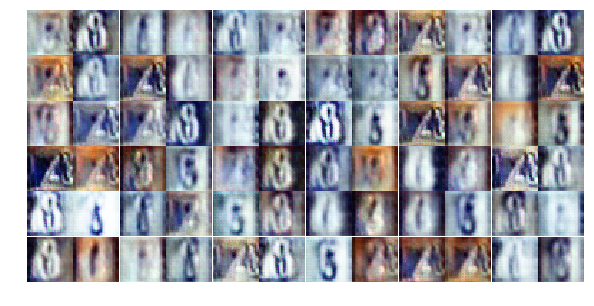

Epoch 21/25... Discriminator Loss: 0.1394... Generator Loss: 3.3810
Epoch 21/25... Discriminator Loss: 0.0703... Generator Loss: 3.8907
Epoch 21/25... Discriminator Loss: 0.3713... Generator Loss: 1.7908
Epoch 21/25... Discriminator Loss: 0.3189... Generator Loss: 2.7076
Epoch 21/25... Discriminator Loss: 0.0725... Generator Loss: 4.9346
Epoch 21/25... Discriminator Loss: 0.0989... Generator Loss: 4.0827
Epoch 21/25... Discriminator Loss: 0.1416... Generator Loss: 3.1611
Epoch 21/25... Discriminator Loss: 0.1267... Generator Loss: 3.0910
Epoch 21/25... Discriminator Loss: 0.2738... Generator Loss: 3.5260
Epoch 21/25... Discriminator Loss: 0.0791... Generator Loss: 3.9761


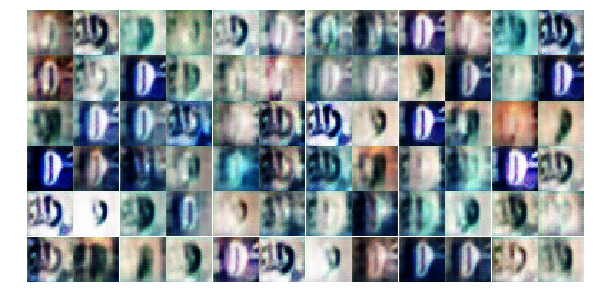

Epoch 21/25... Discriminator Loss: 0.0578... Generator Loss: 4.2028
Epoch 21/25... Discriminator Loss: 0.1567... Generator Loss: 5.3081
Epoch 21/25... Discriminator Loss: 0.1012... Generator Loss: 3.1543
Epoch 21/25... Discriminator Loss: 0.0645... Generator Loss: 3.8134
Epoch 21/25... Discriminator Loss: 0.1096... Generator Loss: 3.7024
Epoch 21/25... Discriminator Loss: 0.1996... Generator Loss: 2.4440
Epoch 21/25... Discriminator Loss: 0.1313... Generator Loss: 3.4618
Epoch 21/25... Discriminator Loss: 0.2148... Generator Loss: 4.7195
Epoch 21/25... Discriminator Loss: 0.3291... Generator Loss: 2.4023
Epoch 21/25... Discriminator Loss: 0.9587... Generator Loss: 2.3025


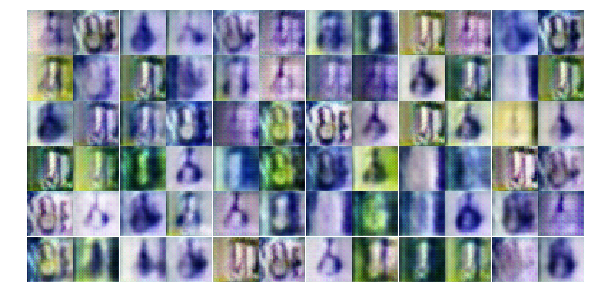

Epoch 21/25... Discriminator Loss: 0.0846... Generator Loss: 4.3036
Epoch 21/25... Discriminator Loss: 0.9880... Generator Loss: 12.9547
Epoch 21/25... Discriminator Loss: 0.1839... Generator Loss: 3.1709
Epoch 21/25... Discriminator Loss: 0.1392... Generator Loss: 4.1107
Epoch 21/25... Discriminator Loss: 0.0929... Generator Loss: 3.5862
Epoch 21/25... Discriminator Loss: 0.0788... Generator Loss: 3.4602
Epoch 21/25... Discriminator Loss: 0.1522... Generator Loss: 3.1425
Epoch 21/25... Discriminator Loss: 0.1112... Generator Loss: 3.8932
Epoch 21/25... Discriminator Loss: 0.1831... Generator Loss: 6.7412
Epoch 21/25... Discriminator Loss: 0.1493... Generator Loss: 3.8862


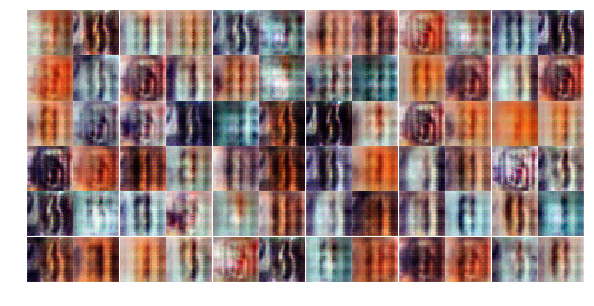

Epoch 21/25... Discriminator Loss: 0.0734... Generator Loss: 4.1636
Epoch 21/25... Discriminator Loss: 0.0817... Generator Loss: 3.9045
Epoch 21/25... Discriminator Loss: 0.6325... Generator Loss: 11.2602
Epoch 22/25... Discriminator Loss: 0.0544... Generator Loss: 4.5896
Epoch 22/25... Discriminator Loss: 0.1515... Generator Loss: 2.8250
Epoch 22/25... Discriminator Loss: 0.1108... Generator Loss: 3.3482
Epoch 22/25... Discriminator Loss: 0.0575... Generator Loss: 4.7469
Epoch 22/25... Discriminator Loss: 0.1057... Generator Loss: 3.0886
Epoch 22/25... Discriminator Loss: 0.1279... Generator Loss: 3.4055
Epoch 22/25... Discriminator Loss: 0.2722... Generator Loss: 2.5189


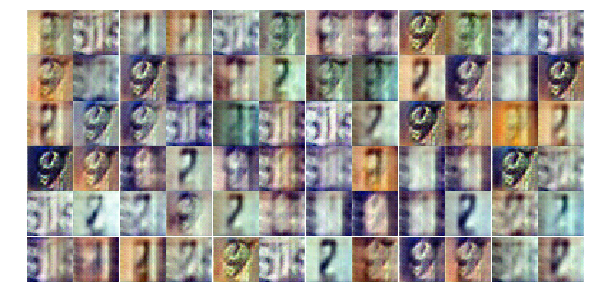

Epoch 22/25... Discriminator Loss: 0.1780... Generator Loss: 4.7128
Epoch 22/25... Discriminator Loss: 0.1106... Generator Loss: 4.4877
Epoch 22/25... Discriminator Loss: 0.0731... Generator Loss: 4.8248
Epoch 22/25... Discriminator Loss: 0.0642... Generator Loss: 4.6800
Epoch 22/25... Discriminator Loss: 0.0511... Generator Loss: 6.0173
Epoch 22/25... Discriminator Loss: 0.8991... Generator Loss: 1.5130
Epoch 22/25... Discriminator Loss: 0.4271... Generator Loss: 7.0700
Epoch 22/25... Discriminator Loss: 0.1561... Generator Loss: 4.0703
Epoch 22/25... Discriminator Loss: 0.1633... Generator Loss: 3.5124
Epoch 22/25... Discriminator Loss: 0.0708... Generator Loss: 4.0760


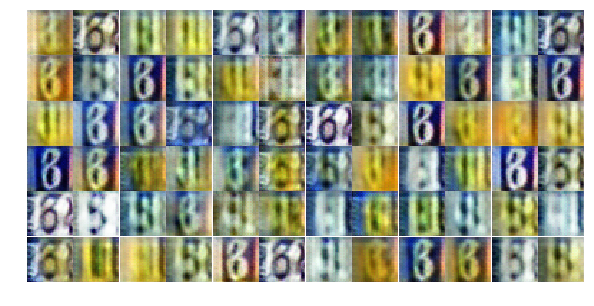

Epoch 22/25... Discriminator Loss: 0.1063... Generator Loss: 4.3686
Epoch 22/25... Discriminator Loss: 0.2998... Generator Loss: 5.0195
Epoch 22/25... Discriminator Loss: 0.1804... Generator Loss: 2.6702
Epoch 22/25... Discriminator Loss: 0.0547... Generator Loss: 5.3941
Epoch 22/25... Discriminator Loss: 0.0584... Generator Loss: 5.9434
Epoch 22/25... Discriminator Loss: 0.0596... Generator Loss: 4.1232
Epoch 22/25... Discriminator Loss: 0.0852... Generator Loss: 4.2200
Epoch 22/25... Discriminator Loss: 0.1295... Generator Loss: 3.0835
Epoch 22/25... Discriminator Loss: 0.0521... Generator Loss: 4.3275
Epoch 22/25... Discriminator Loss: 0.0706... Generator Loss: 3.9811


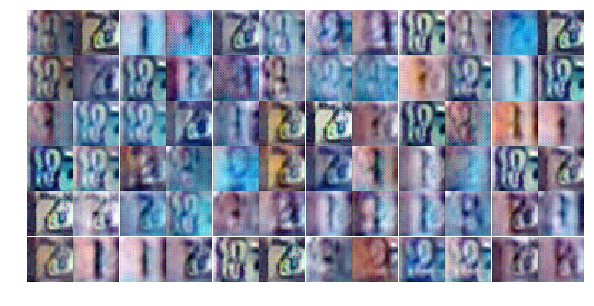

Epoch 22/25... Discriminator Loss: 0.0244... Generator Loss: 7.1305
Epoch 22/25... Discriminator Loss: 0.1570... Generator Loss: 2.9553
Epoch 22/25... Discriminator Loss: 0.0928... Generator Loss: 4.4627
Epoch 22/25... Discriminator Loss: 0.0968... Generator Loss: 3.6701
Epoch 22/25... Discriminator Loss: 0.0753... Generator Loss: 4.1323
Epoch 22/25... Discriminator Loss: 0.1512... Generator Loss: 2.8376
Epoch 22/25... Discriminator Loss: 0.2195... Generator Loss: 2.7219
Epoch 22/25... Discriminator Loss: 0.0701... Generator Loss: 4.4789
Epoch 22/25... Discriminator Loss: 0.0855... Generator Loss: 4.2431
Epoch 22/25... Discriminator Loss: 0.1690... Generator Loss: 7.6745


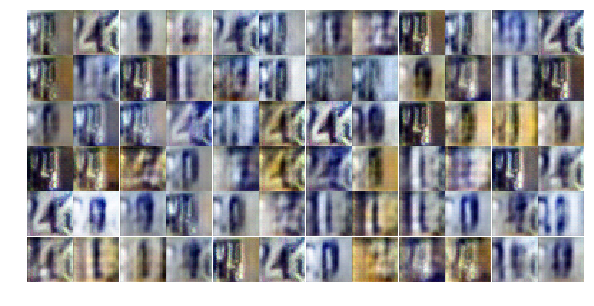

Epoch 22/25... Discriminator Loss: 0.5365... Generator Loss: 2.3003
Epoch 22/25... Discriminator Loss: 0.0484... Generator Loss: 5.3836
Epoch 22/25... Discriminator Loss: 0.0544... Generator Loss: 5.5371
Epoch 22/25... Discriminator Loss: 0.0810... Generator Loss: 5.2942
Epoch 22/25... Discriminator Loss: 0.4485... Generator Loss: 8.9797
Epoch 22/25... Discriminator Loss: 0.0723... Generator Loss: 3.7411
Epoch 22/25... Discriminator Loss: 0.2972... Generator Loss: 2.0958
Epoch 22/25... Discriminator Loss: 0.4826... Generator Loss: 1.9495
Epoch 22/25... Discriminator Loss: 0.1171... Generator Loss: 4.6453
Epoch 22/25... Discriminator Loss: 0.0873... Generator Loss: 6.0786


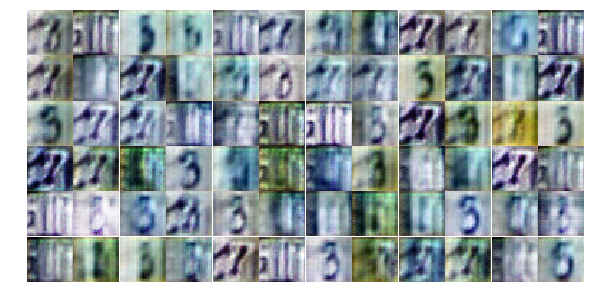

Epoch 22/25... Discriminator Loss: 0.2975... Generator Loss: 4.2848
Epoch 22/25... Discriminator Loss: 0.0967... Generator Loss: 3.9981
Epoch 22/25... Discriminator Loss: 0.0608... Generator Loss: 3.8882
Epoch 22/25... Discriminator Loss: 0.0799... Generator Loss: 3.8965
Epoch 22/25... Discriminator Loss: 0.0941... Generator Loss: 4.3388
Epoch 22/25... Discriminator Loss: 0.0516... Generator Loss: 4.9022
Epoch 22/25... Discriminator Loss: 0.1342... Generator Loss: 10.6683
Epoch 22/25... Discriminator Loss: 0.4944... Generator Loss: 5.8345
Epoch 22/25... Discriminator Loss: 1.4718... Generator Loss: 12.6767
Epoch 22/25... Discriminator Loss: 0.1933... Generator Loss: 2.7078


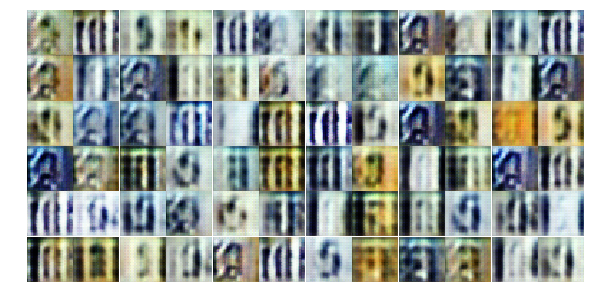

Epoch 23/25... Discriminator Loss: 0.1376... Generator Loss: 3.3783
Epoch 23/25... Discriminator Loss: 0.2022... Generator Loss: 4.9023
Epoch 23/25... Discriminator Loss: 0.0599... Generator Loss: 5.3734
Epoch 23/25... Discriminator Loss: 0.1616... Generator Loss: 2.6567
Epoch 23/25... Discriminator Loss: 0.1101... Generator Loss: 3.2493
Epoch 23/25... Discriminator Loss: 0.3244... Generator Loss: 1.9695
Epoch 23/25... Discriminator Loss: 0.0867... Generator Loss: 3.7350
Epoch 23/25... Discriminator Loss: 0.0527... Generator Loss: 7.1657
Epoch 23/25... Discriminator Loss: 0.0999... Generator Loss: 3.1377
Epoch 23/25... Discriminator Loss: 0.0790... Generator Loss: 4.1860


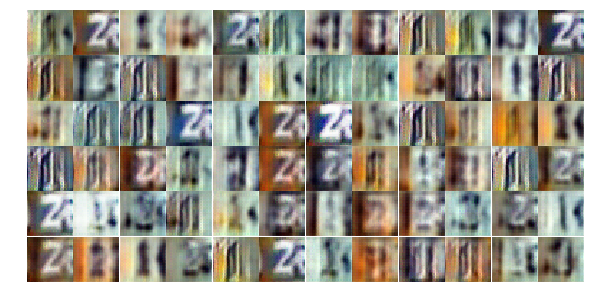

Epoch 23/25... Discriminator Loss: 0.2004... Generator Loss: 2.6602
Epoch 23/25... Discriminator Loss: 0.1647... Generator Loss: 2.9440
Epoch 23/25... Discriminator Loss: 0.0448... Generator Loss: 5.2844
Epoch 23/25... Discriminator Loss: 0.1204... Generator Loss: 3.5051
Epoch 23/25... Discriminator Loss: 0.0445... Generator Loss: 5.0584
Epoch 23/25... Discriminator Loss: 0.0636... Generator Loss: 5.4521
Epoch 23/25... Discriminator Loss: 0.0218... Generator Loss: 7.0309
Epoch 23/25... Discriminator Loss: 0.0733... Generator Loss: 9.7508
Epoch 23/25... Discriminator Loss: 1.4766... Generator Loss: 0.7982
Epoch 23/25... Discriminator Loss: 0.3904... Generator Loss: 7.1742


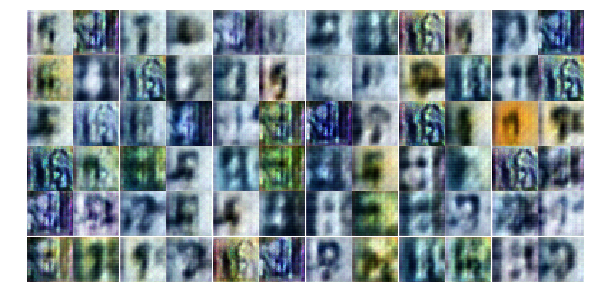

Epoch 23/25... Discriminator Loss: 0.2917... Generator Loss: 6.4554
Epoch 23/25... Discriminator Loss: 0.3186... Generator Loss: 2.3973
Epoch 23/25... Discriminator Loss: 0.1776... Generator Loss: 6.8968
Epoch 23/25... Discriminator Loss: 0.1166... Generator Loss: 4.7625
Epoch 23/25... Discriminator Loss: 0.0348... Generator Loss: 5.0861
Epoch 23/25... Discriminator Loss: 0.2059... Generator Loss: 2.5167
Epoch 23/25... Discriminator Loss: 0.0861... Generator Loss: 4.6803
Epoch 23/25... Discriminator Loss: 0.2436... Generator Loss: 6.4496
Epoch 23/25... Discriminator Loss: 0.0713... Generator Loss: 5.1889
Epoch 23/25... Discriminator Loss: 0.1039... Generator Loss: 3.6608


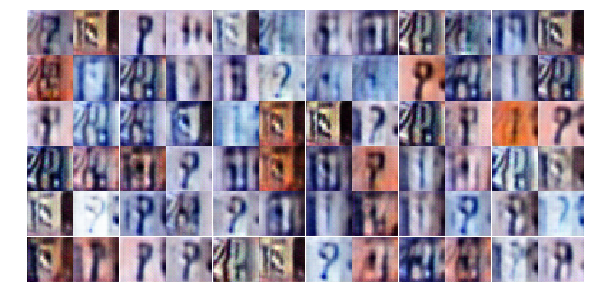

Epoch 23/25... Discriminator Loss: 0.0873... Generator Loss: 3.6381
Epoch 23/25... Discriminator Loss: 0.0424... Generator Loss: 5.6075
Epoch 23/25... Discriminator Loss: 0.1106... Generator Loss: 4.3721
Epoch 23/25... Discriminator Loss: 0.1790... Generator Loss: 3.5699
Epoch 23/25... Discriminator Loss: 0.2166... Generator Loss: 2.5625
Epoch 23/25... Discriminator Loss: 0.0867... Generator Loss: 4.9496
Epoch 23/25... Discriminator Loss: 0.5560... Generator Loss: 11.0626
Epoch 23/25... Discriminator Loss: 0.1793... Generator Loss: 2.9751
Epoch 23/25... Discriminator Loss: 0.1378... Generator Loss: 6.1367
Epoch 23/25... Discriminator Loss: 0.0829... Generator Loss: 3.6324


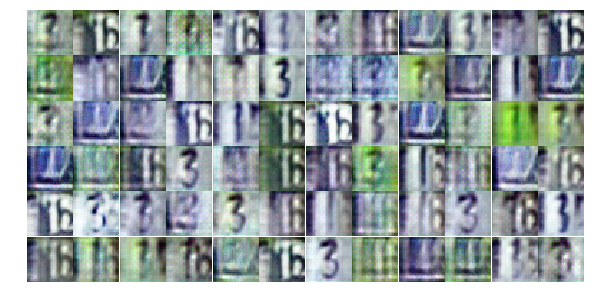

Epoch 23/25... Discriminator Loss: 0.0125... Generator Loss: 6.1775
Epoch 23/25... Discriminator Loss: 0.0172... Generator Loss: 5.9351
Epoch 23/25... Discriminator Loss: 0.0084... Generator Loss: 7.5308
Epoch 23/25... Discriminator Loss: 0.0402... Generator Loss: 6.4108
Epoch 23/25... Discriminator Loss: 0.2395... Generator Loss: 2.4533
Epoch 23/25... Discriminator Loss: 0.2498... Generator Loss: 3.6603
Epoch 23/25... Discriminator Loss: 0.7321... Generator Loss: 9.2744
Epoch 23/25... Discriminator Loss: 0.2033... Generator Loss: 4.5167
Epoch 23/25... Discriminator Loss: 0.3583... Generator Loss: 1.9554
Epoch 23/25... Discriminator Loss: 0.2145... Generator Loss: 2.8175


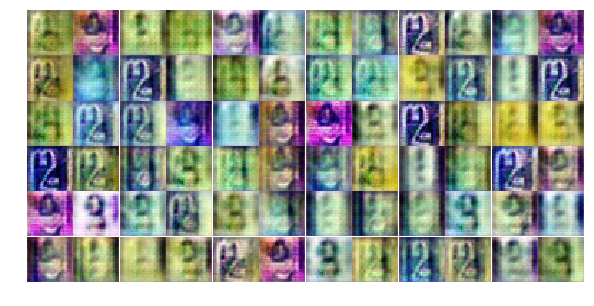

Epoch 23/25... Discriminator Loss: 0.1708... Generator Loss: 2.9746
Epoch 23/25... Discriminator Loss: 0.9368... Generator Loss: 7.9248
Epoch 23/25... Discriminator Loss: 0.2191... Generator Loss: 2.9752
Epoch 23/25... Discriminator Loss: 0.0665... Generator Loss: 5.5982
Epoch 23/25... Discriminator Loss: 0.0836... Generator Loss: 4.4511
Epoch 23/25... Discriminator Loss: 0.2102... Generator Loss: 3.6988
Epoch 23/25... Discriminator Loss: 0.2131... Generator Loss: 2.4415
Epoch 24/25... Discriminator Loss: 0.0923... Generator Loss: 4.0915
Epoch 24/25... Discriminator Loss: 0.1816... Generator Loss: 2.7939
Epoch 24/25... Discriminator Loss: 0.0740... Generator Loss: 3.7323


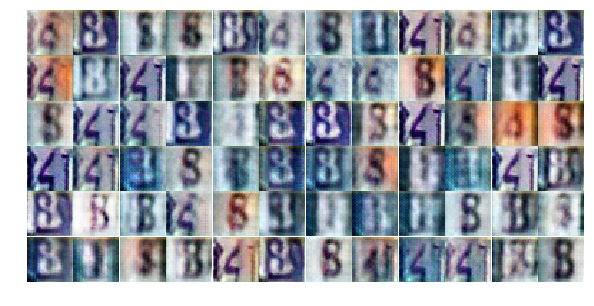

Epoch 24/25... Discriminator Loss: 0.2620... Generator Loss: 9.7172
Epoch 24/25... Discriminator Loss: 0.4170... Generator Loss: 2.2599
Epoch 24/25... Discriminator Loss: 0.1378... Generator Loss: 3.2625
Epoch 24/25... Discriminator Loss: 0.3228... Generator Loss: 7.0974
Epoch 24/25... Discriminator Loss: 0.1015... Generator Loss: 3.2124
Epoch 24/25... Discriminator Loss: 0.4055... Generator Loss: 2.0201
Epoch 24/25... Discriminator Loss: 0.1793... Generator Loss: 3.0935
Epoch 24/25... Discriminator Loss: 0.1022... Generator Loss: 3.2174
Epoch 24/25... Discriminator Loss: 0.1964... Generator Loss: 2.8704
Epoch 24/25... Discriminator Loss: 0.0645... Generator Loss: 5.9122


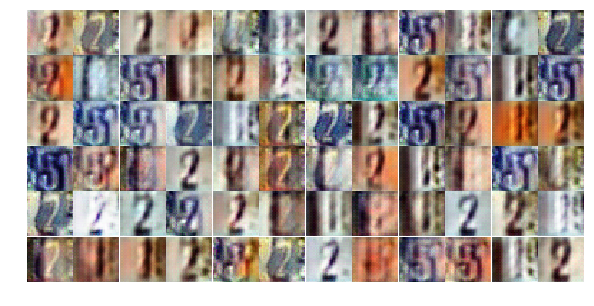

Epoch 24/25... Discriminator Loss: 0.2571... Generator Loss: 3.1502
Epoch 24/25... Discriminator Loss: 2.4545... Generator Loss: 0.3267
Epoch 24/25... Discriminator Loss: 3.0644... Generator Loss: 0.5858
Epoch 24/25... Discriminator Loss: 1.2660... Generator Loss: 2.0617
Epoch 24/25... Discriminator Loss: 0.1263... Generator Loss: 8.5804
Epoch 24/25... Discriminator Loss: 0.0542... Generator Loss: 5.5270
Epoch 24/25... Discriminator Loss: 0.1781... Generator Loss: 10.0500
Epoch 24/25... Discriminator Loss: 0.1197... Generator Loss: 4.0516


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))